In [1]:
import os
import inspect
import seaborn
import matplotlib
import matplotlib.pyplot as plt
import torch
import scanpy as sc
import tqdm
import sys
import pickle
import PyComplexHeatmap as pch
import scvi
import IPython
import scipy
import pandas as pd
import numpy as np
import anndata
import gseapy
import statannotations
from statannotations.Annotator import Annotator

sc.settings.figdir=os.path.expanduser('~/WbFigures/DevFinalAnalysis/')
sc._settings.settings._vector_friendly=True

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if torch.cuda.is_available():
    print("GPU is available")
    print("Number of GPUs:", torch.cuda.device_count())
    print("GPU Name:", torch.cuda.get_device_name(0))
else:
    print("GPU is not available")

sys.path.append('/home/matthew.schmitz/utils/mts-utils/')
from genomics import sc_analysis


import sys
import antipode
import antipode.antipode_model
import antipode.model_functions
import antipode.model_distributions
import antipode.model_modules
import antipode.train_utils
import antipode.plotting
import antipode.post

from antipode.post import uniqlist
import cuml


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


GPU is available
Number of GPUs: 1
GPU Name: NVIDIA A100-PCIE-40GB


In [2]:
# import scanpy as sc
# adata = sc.read_h5ad('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/HvQvM/HvQvM_cere_noX_mousectx.h5ad')
# print(adata)
# adata = adata[adata.obs['region']!='DRG',:]
# print(adata)
# adata.write_h5ad('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/HvQvM/HvQvM_cere_noX_mousectx.h5ad')
# print(adata)

In [3]:
%pprint

Pretty printing has been turned OFF


In [4]:
batch_key='batch_name'
discov_key='species'
layer_key='spliced'
MDE_KEY = "X_antipode_UMAP"
leaf_key = 'level_2'
anndata.settings.allow_write_nullable_strings = True

model_tag   = '1.9.1.8.5_Dev_final_600clusters'
model_path='/home/matthew.schmitz/Matthew/models/'+model_tag
adata = sc.read_h5ad(os.path.join(model_path,'p3_adata.h5ad'))
antipode_model=antipode.antipode_model.ANTIPODE.load(model_path,adata=adata,prefix='p3_',device=device)
antipode_model.save_params_to_uns()
adata=antipode_model.adata_manager.adata
pstore = adata.uns['param_store']

INFO     Generating sequential column names                                                                        


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/pyro/params/param_store.py:334: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s

In [5]:
# for i in [0,42,129,999,2222222]:
#     print(i)
#     umap = cuml.UMAP(n_neighbors = 60,min_dist=0.2,spread=1,metric='manhattan',init='spectral',random_state=i)
#     adata.obsm[MDE_KEY] = clip_latent_dimensions(umap.fit_transform(adata.obsm['X_antipode']),0.05)
#     sc.pl.embedding(
#         adata,
#         basis=MDE_KEY,
#         legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
#         color=['ccl_extended']
#     )


In [6]:
import h5py
with h5py.File('/home/matthew.schmitz/Matthew/models/1.9.1.8.5_Dev_final_looser/analysis_inprogress.h5ad') as f:
    obs = anndata.io.read_elem(f['obs'])
adata.obs['prev_level_2'] = obs['level_2'].astype(str)


In [8]:
# cur_prev_l2 = adata.obs.groupby('prev_level_2')['level_2'].value_counts().unstack().idxmax(0).to_dict()
# cur_l1 = adata.obs.groupby('level_2')['level_1'].value_counts().unstack().T.idxmax(0).to_dict()

/scratch/fast/1446487/ipykernel_3770489/3348001486.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cur_l1 = adata.obs.groupby('level_2')['level_1'].value_counts().unstack().T.idxmax(0).to_dict()


In [ ]:
# tab = pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/annotations/cluster_meta_5.tsv',sep='\t')
# tab.index = list(tab['level_2'].astype(str))
# new_rows = []
# for x in adata.obs['level_2'].unique():
#     new_rows.append(tab.loc[cur_prev_l2[x],:])
#     old_l2 = str(new_rows[-1]['level_2'])
#     new_rows[-1]['level_2'] = x
#     new_rows[-1]['level_1'] = cur_l1[x]

# new_cluster_meta = pd.concat(new_rows,axis=1).T

In [32]:
new_obs = pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/annotations/cluster_meta_5.tsv',sep='\t',index_col=0)
ncols = new_obs.columns
new_obs
for c in ncols:
    d = dict(zip(new_obs.index.astype(str),new_obs[c]))
    if c in adata.obs.columns:
        adata.obs[c] = adata.obs[c].astype(str)
    adata.obs[c] = adata.obs['level_2'].replace(d)

/scratch/fast/1446487/ipykernel_3770489/3065013036.py:8: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs[c] = adata.obs['level_2'].replace(d)
/scratch/fast/1446487/ipykernel_3770489/3065013036.py:8: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs[c] = adata.obs['level_2'].replace(d)
/scratch/fast/1446487/ipykernel_3770489/3065013036.py:8: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categ

In [22]:
mappings=pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/annotations/many_mappings3.txt.gz',index_col=0)
mappings=mappings.rename({leaf_key:'anno_level_2'},axis=1)
adata.obs.loc[:,mappings.columns] = mappings
adata.obs.loc[:,mappings.columns] = adata.obs.loc[:,mappings.columns].astype(str)

/scratch/fast/1446487/ipykernel_3770489/796571500.py:1: DtypeWarning: Columns (2,9,10,11,12) have mixed types. Specify dtype option on import or set low_memory=False.
  mappings=pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/annotations/many_mappings3.txt.gz',index_col=0)
/scratch/fast/1446487/ipykernel_3770489/796571500.py:3: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[  2. 422. 161. ...  89. 357. 546.]' has dtype incompatible with category, please explicitly cast to a compatible dtype first.
  adata.obs.loc[:,mappings.columns] = mappings
/scratch/fast/1446487/ipykernel_3770489/796571500.py:3: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ...
 'SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_musculus_RNA-Seq_kOut'
 'SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_musculus_RNA-Seq_kOut'
 'SRR12082764_GSM4635081_RNA-Seq_P1_r

In [ ]:
# mappings=pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/annotations/clustermeta1_to_cell_annotations.tsv',sep='\t',index_col=0)
# adata.obs.loc[:,mappings.columns] = mappings
# adata.obs.loc[:,mappings.columns] = adata.obs.loc[:,mappings.columns].astype(str)
# for x in ['Neighborhood','Division','Initial_Class','Initial_Class_markers']:
#     adata.obs[x] = adata.obs['level_2'].replace(dict(zip(new_cluster_meta['level_2'],new_cluster_meta[x].astype(str))))

iteration 0


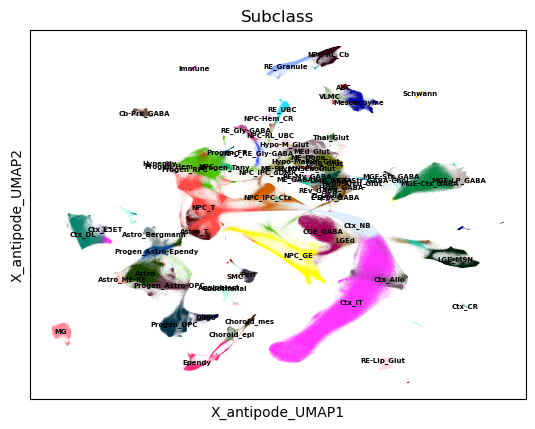

iteration 1


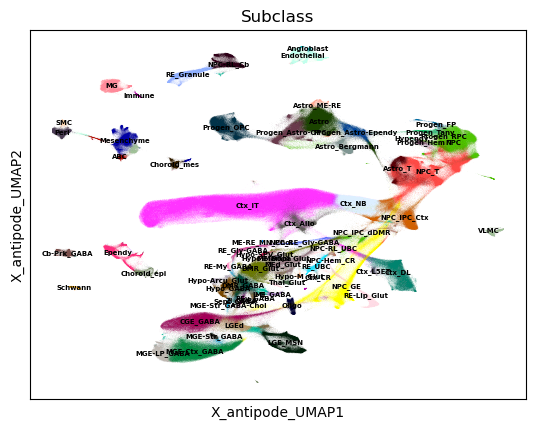

iteration 2


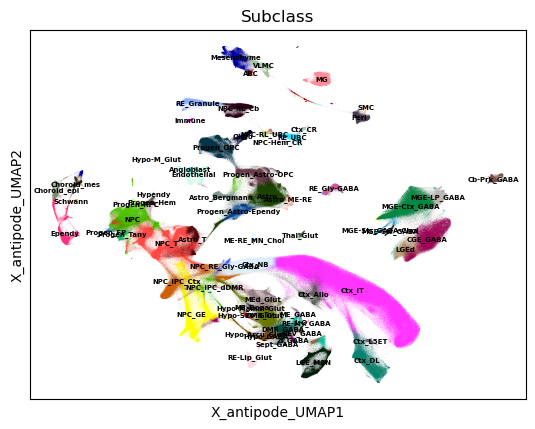

iteration 3


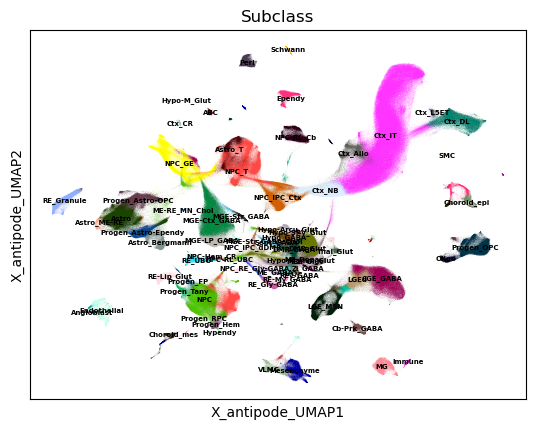

iteration 4


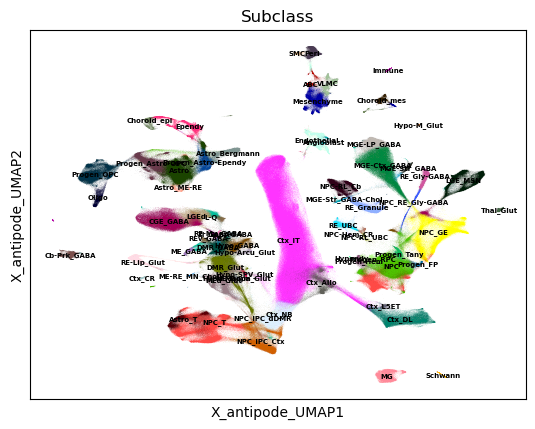

iteration 5


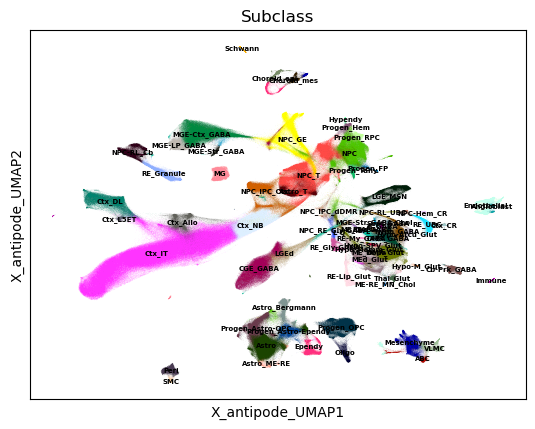

iteration 6


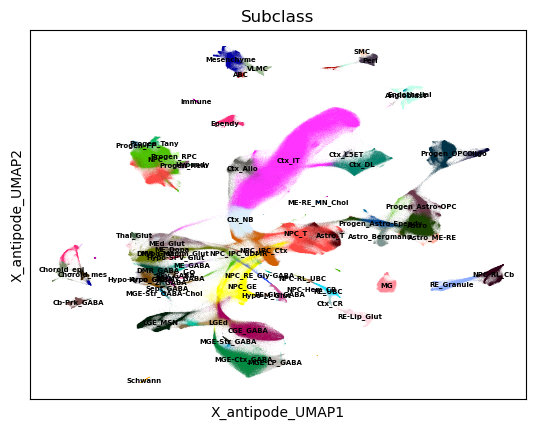

iteration 7


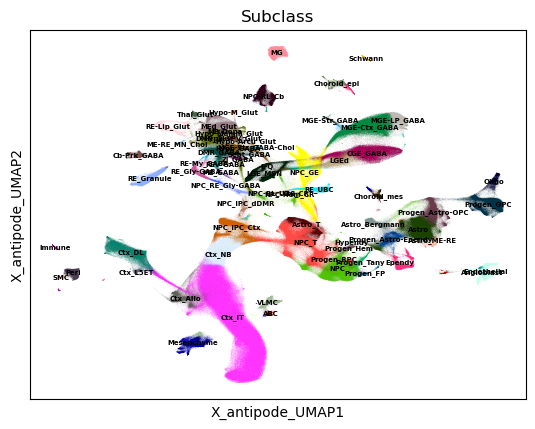

iteration 8


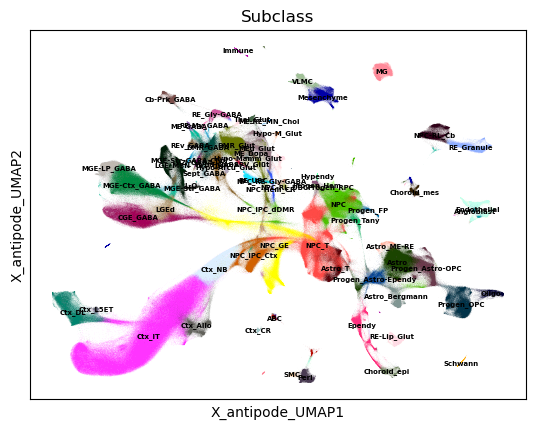

iteration 9


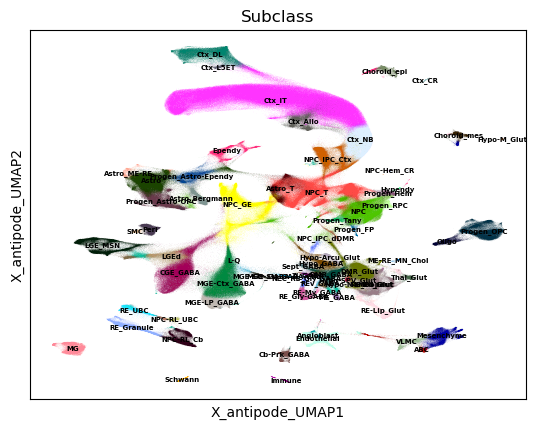

iteration 10


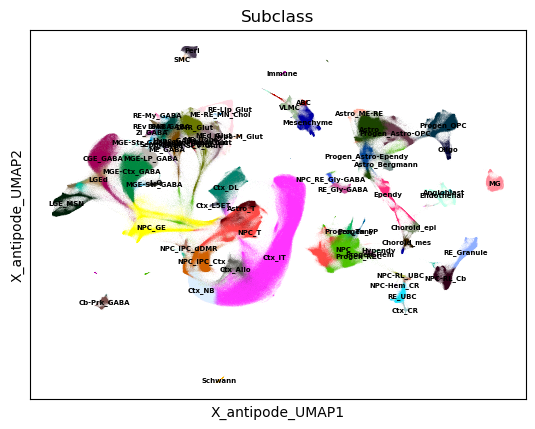

iteration 11


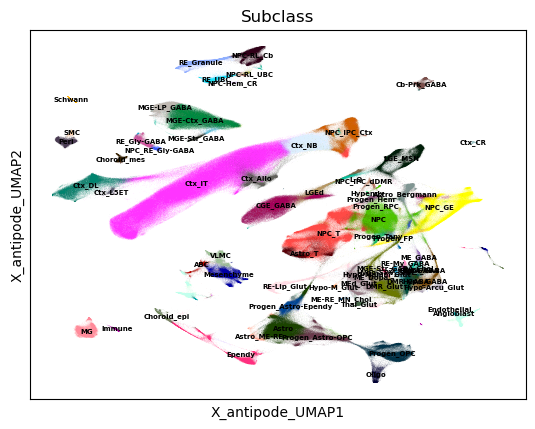

iteration 12


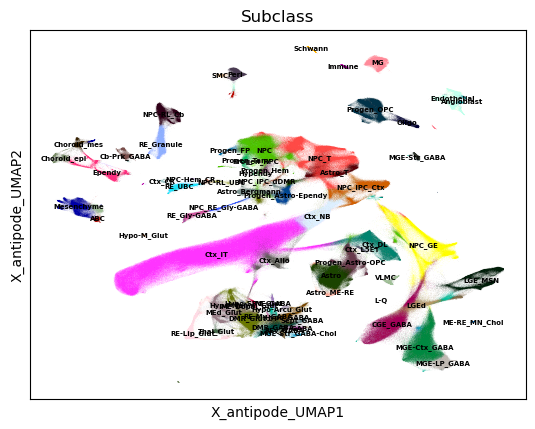

iteration 13


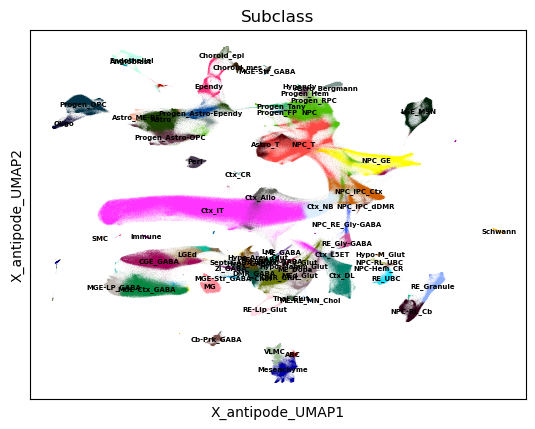

iteration 14


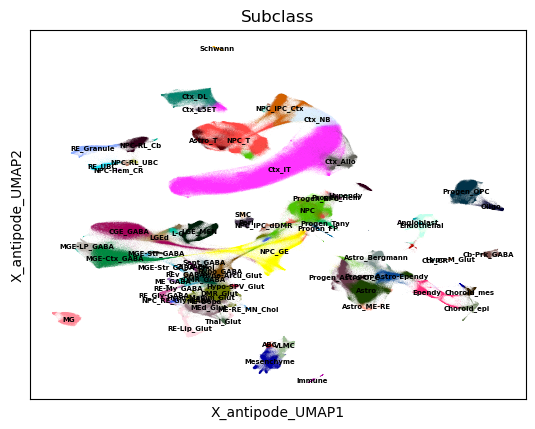

iteration 15


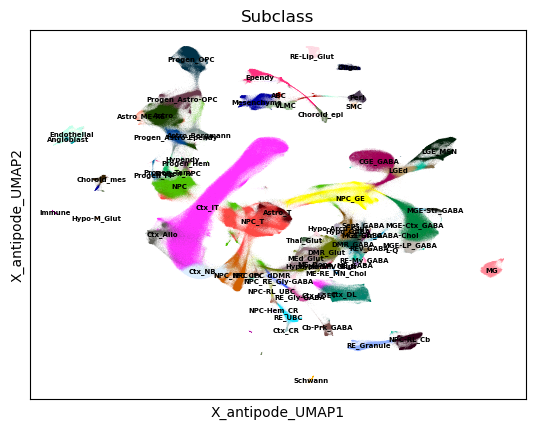

iteration 16


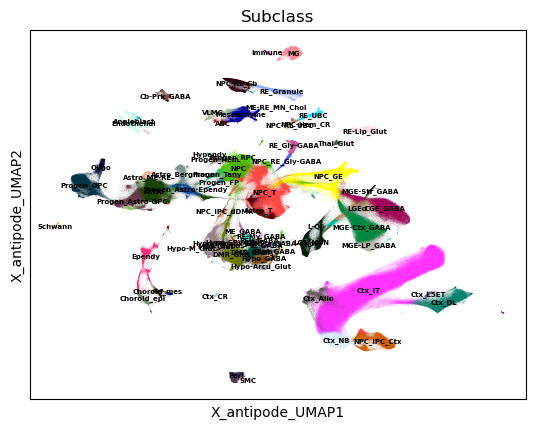

iteration 17


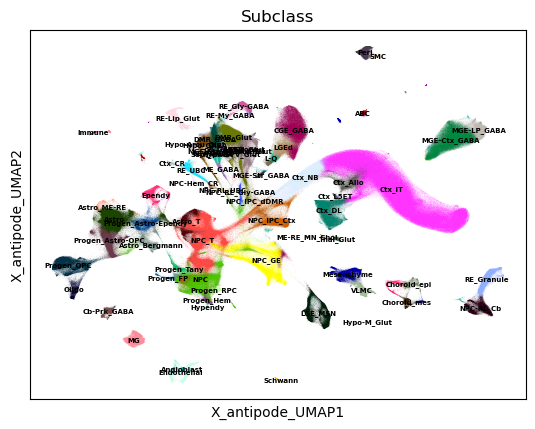

iteration 18


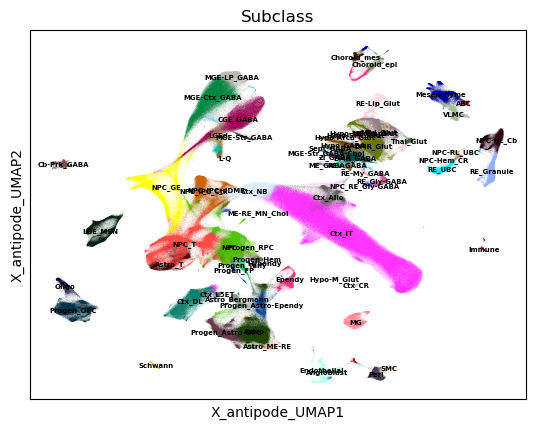

iteration 19


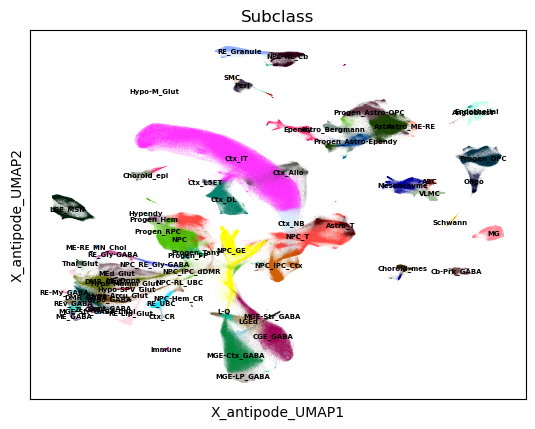

iteration 20


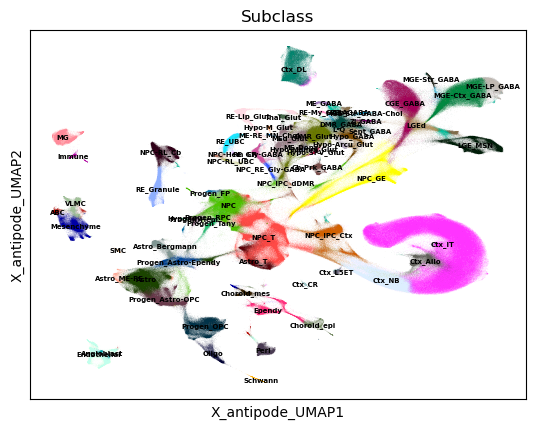

iteration 21


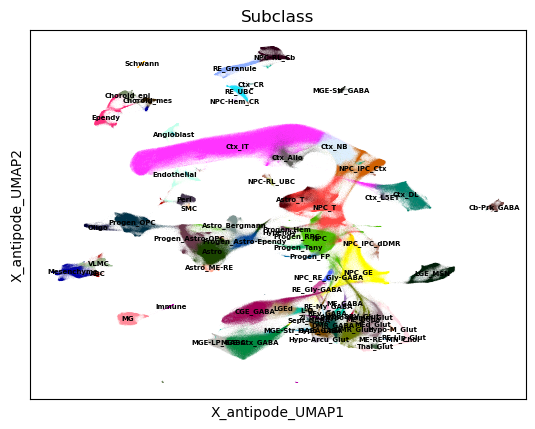

iteration 22


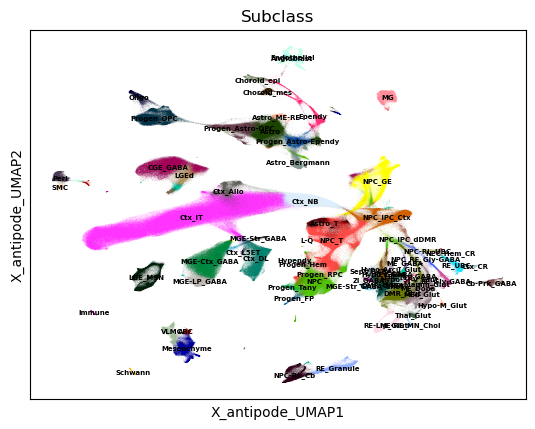

iteration 23


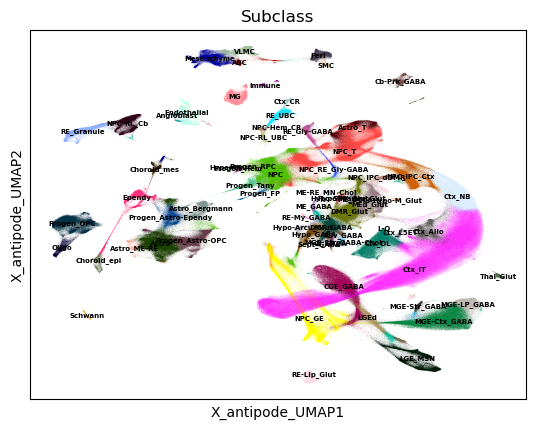

iteration 24


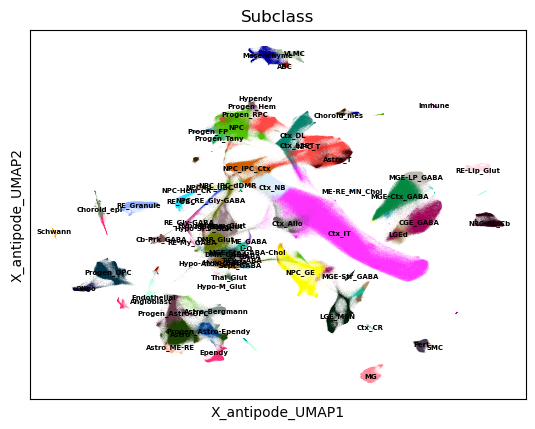

iteration 25


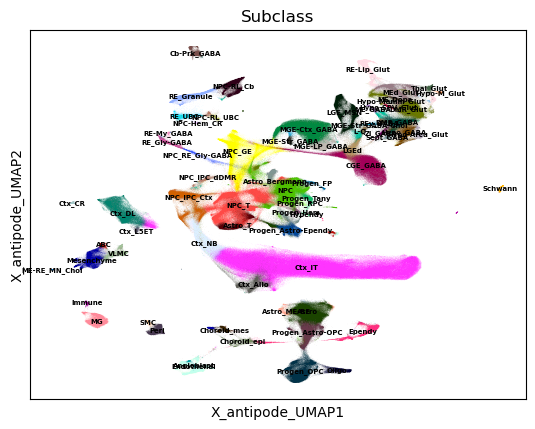

iteration 26


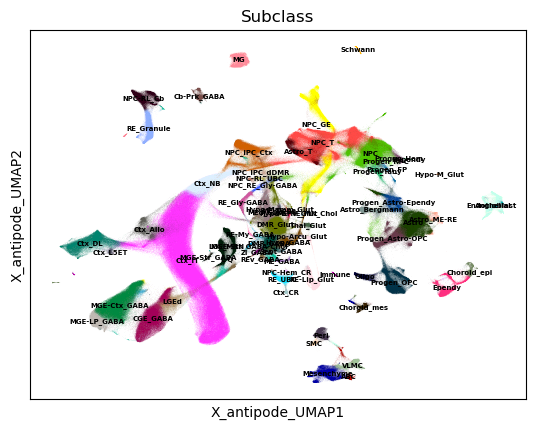

iteration 27


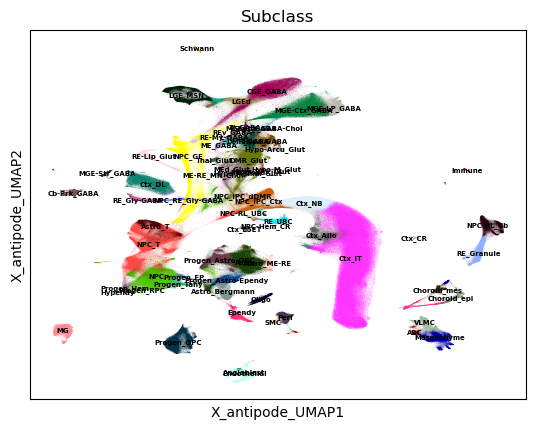

iteration 28


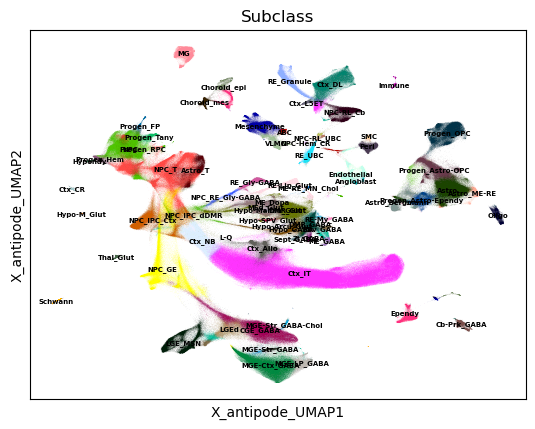

iteration 29


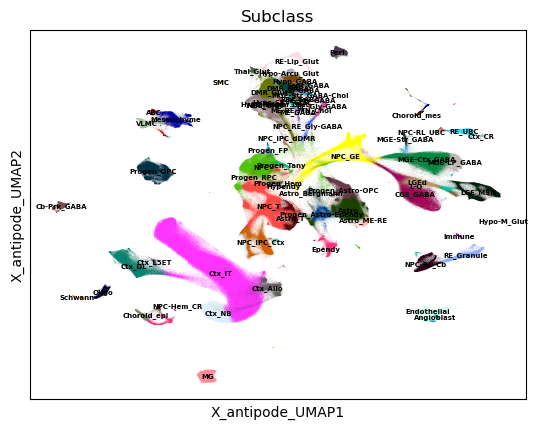

iteration 30


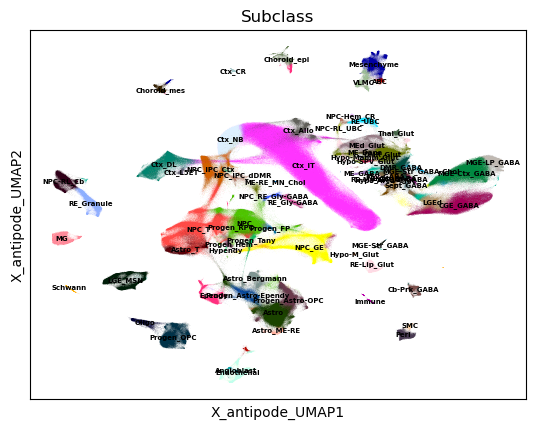

iteration 31


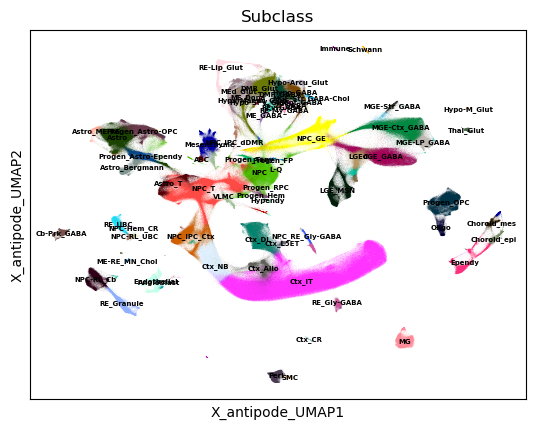

iteration 32


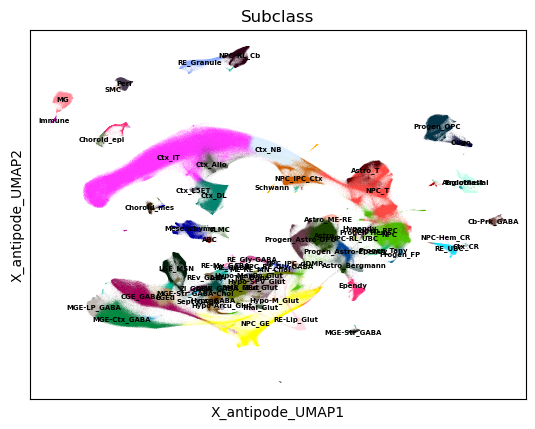

iteration 33


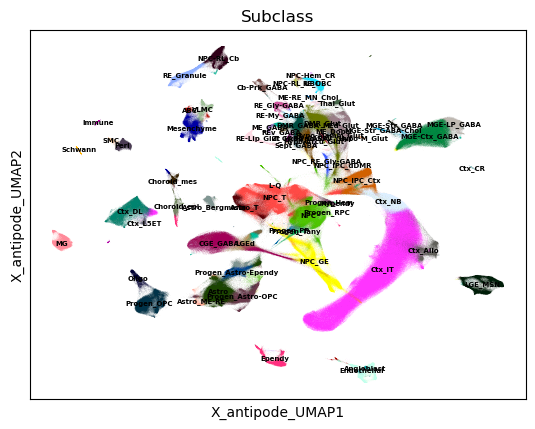

iteration 34


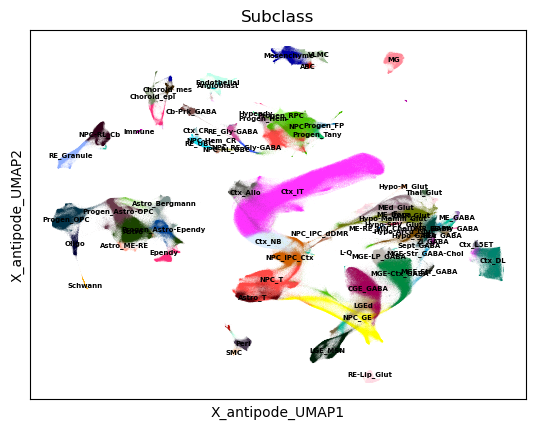

iteration 35


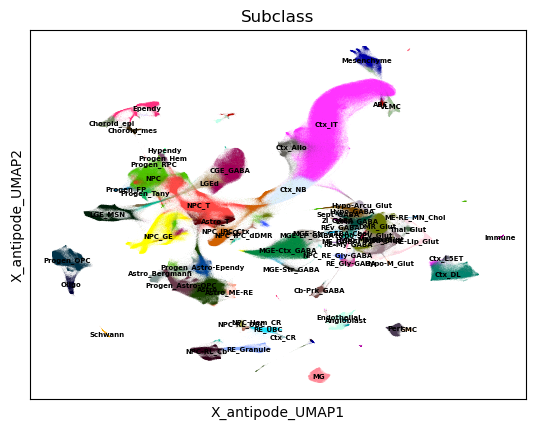

iteration 36


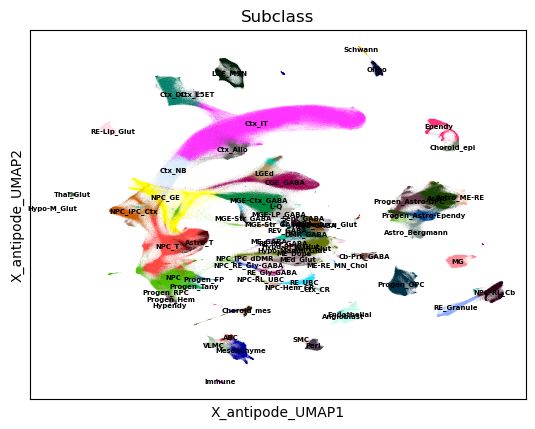

iteration 37


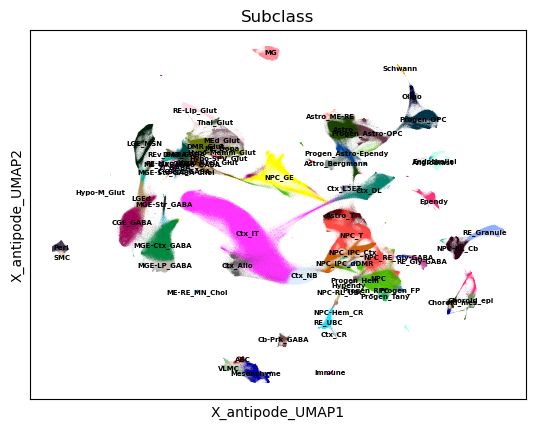

iteration 38


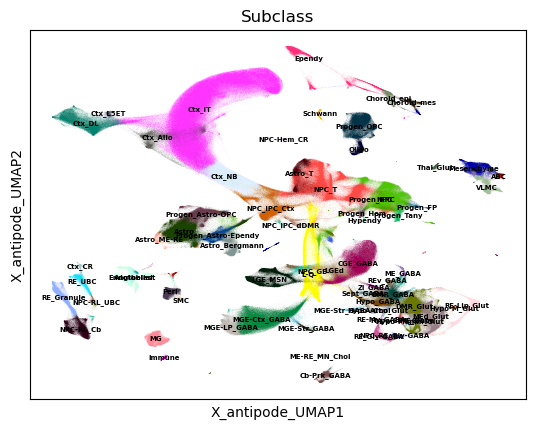

iteration 39


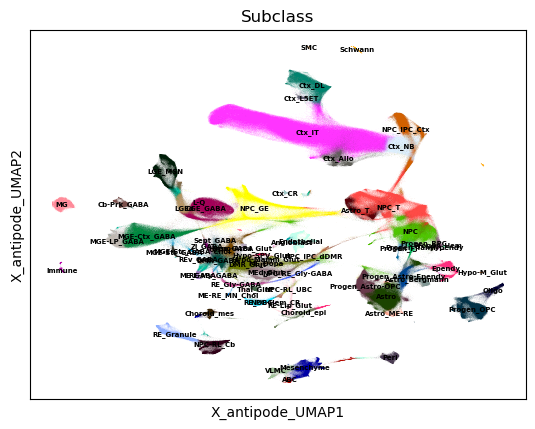

iteration 40


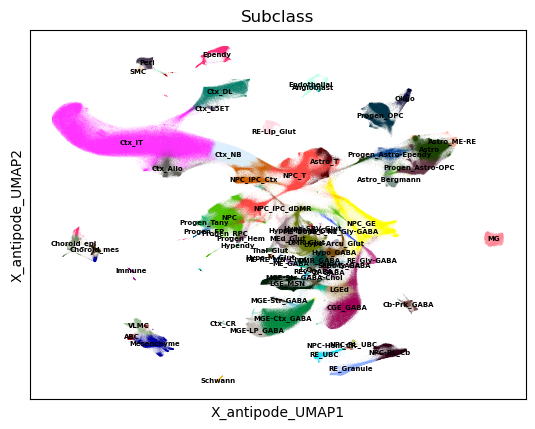

iteration 41


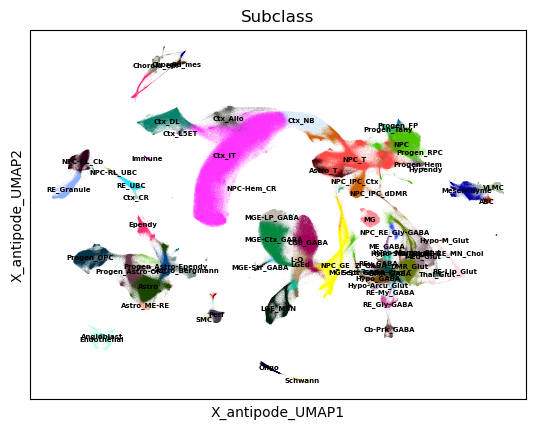

iteration 42


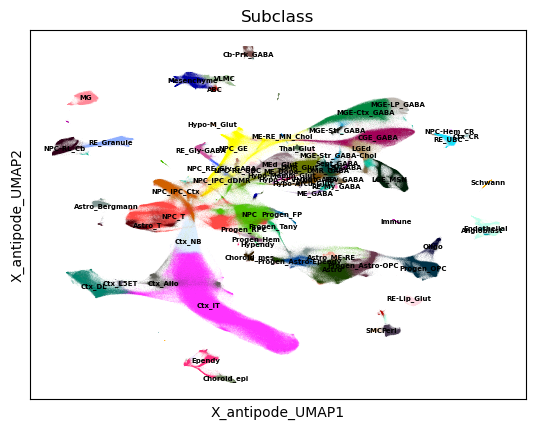

iteration 43


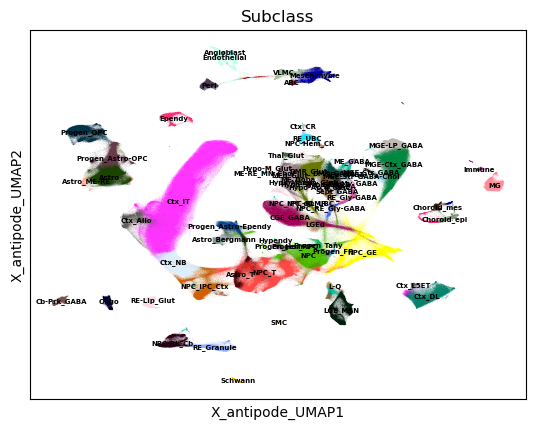

iteration 44


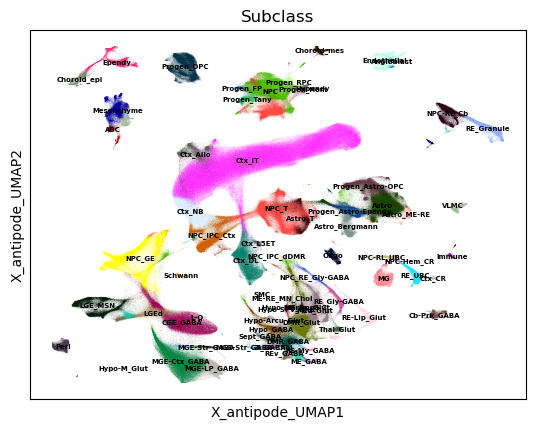

iteration 45


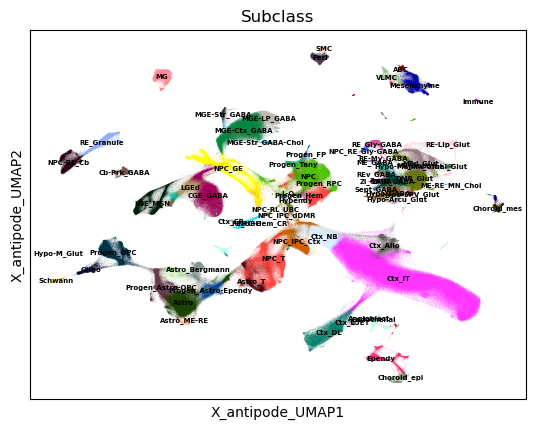

iteration 46


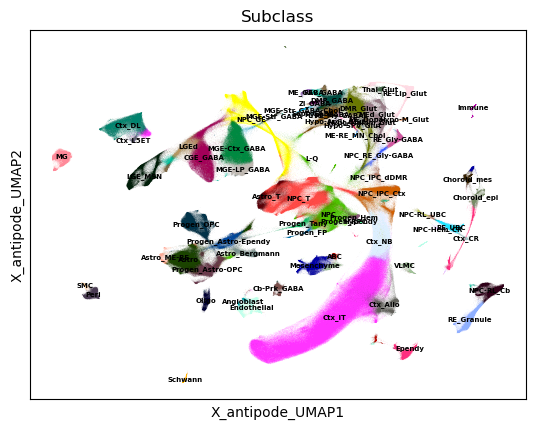

iteration 47


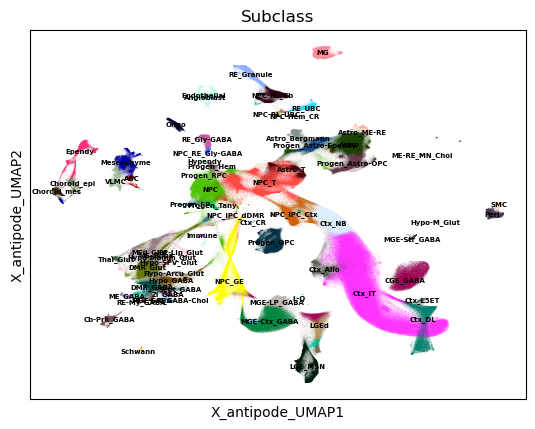

iteration 48


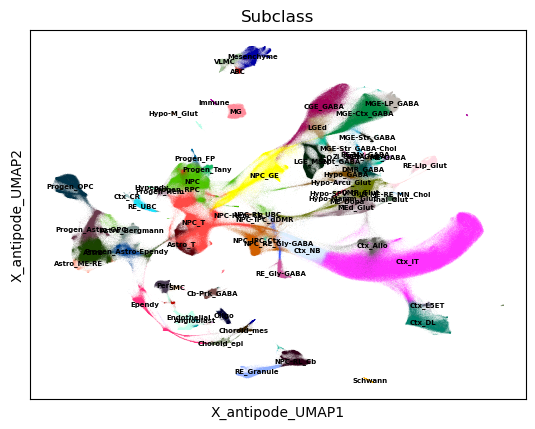

iteration 49


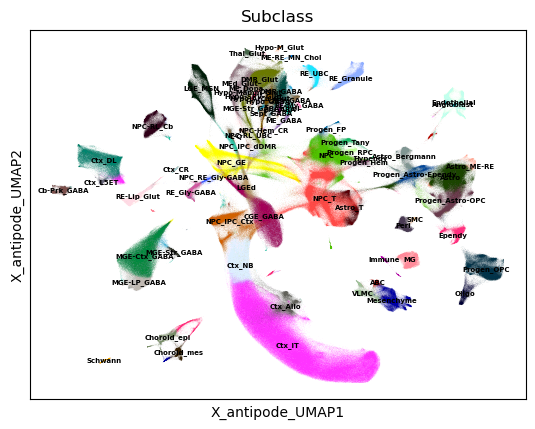

iteration 50


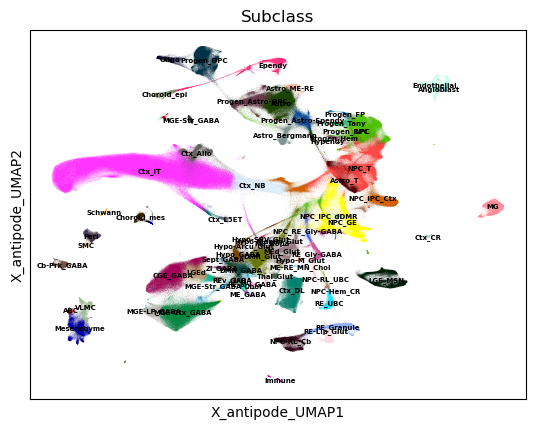

iteration 51


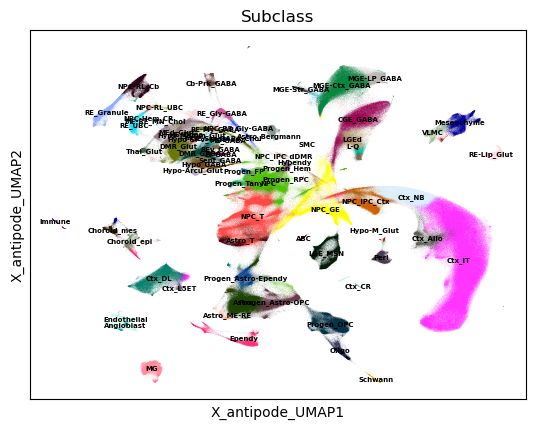

iteration 52


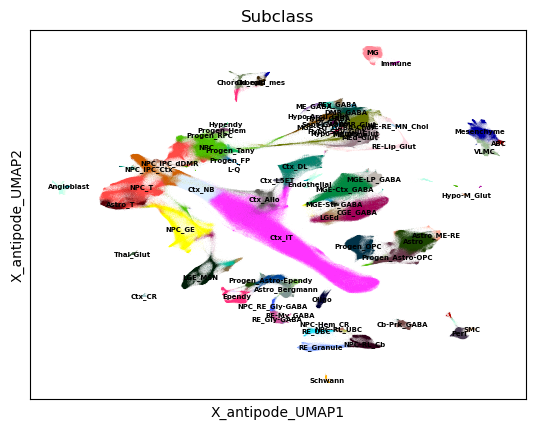

iteration 53


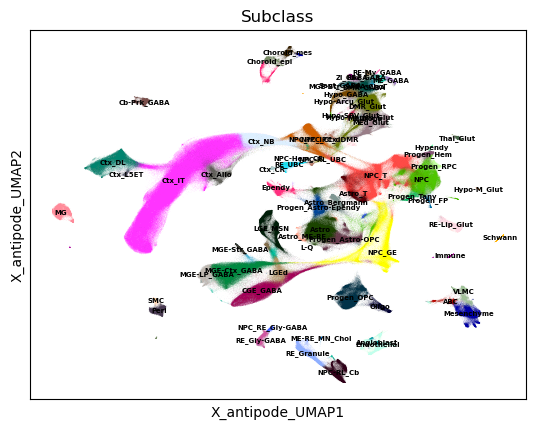

iteration 54


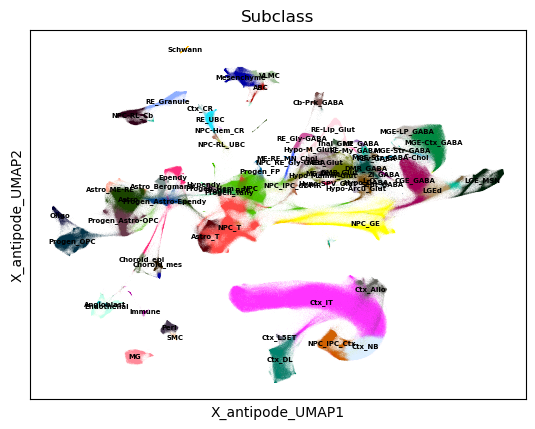

iteration 55


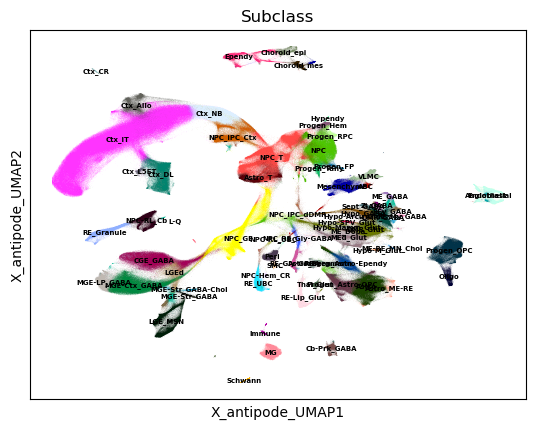

iteration 56


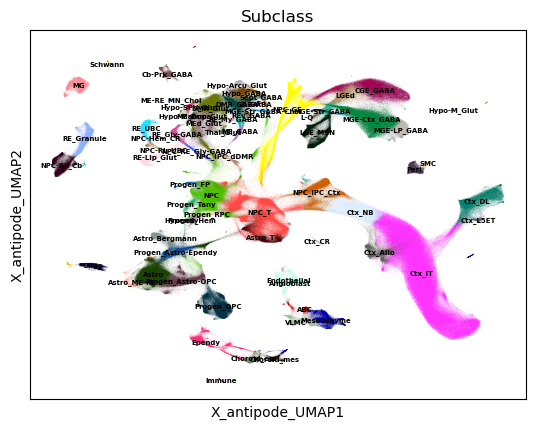

iteration 57


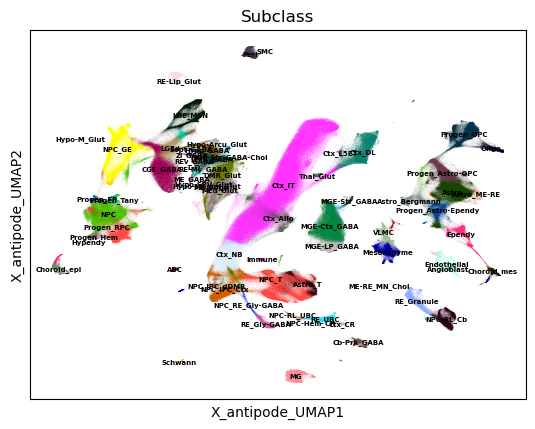

iteration 58


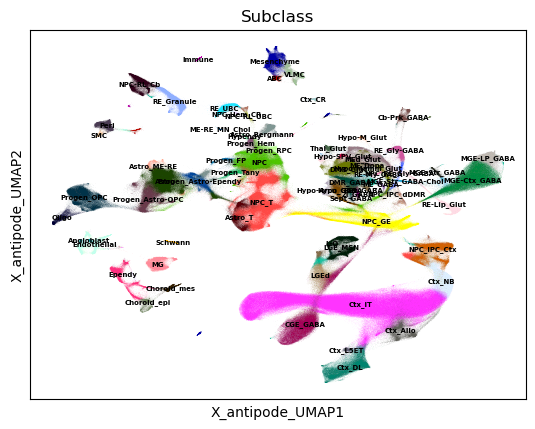

iteration 59


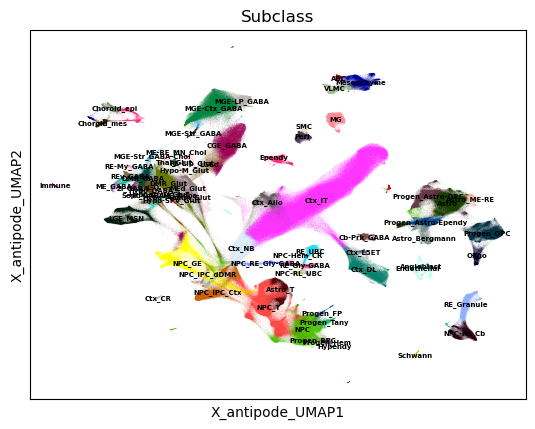

iteration 60


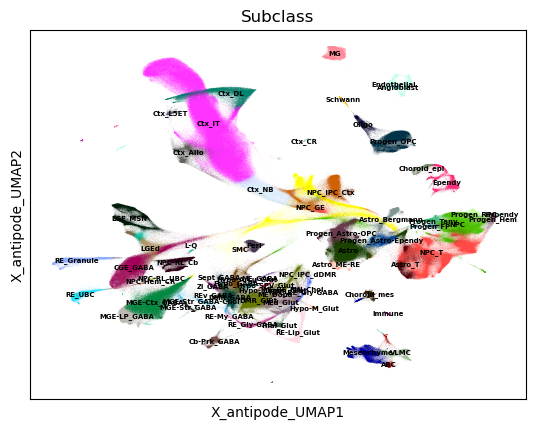

iteration 61


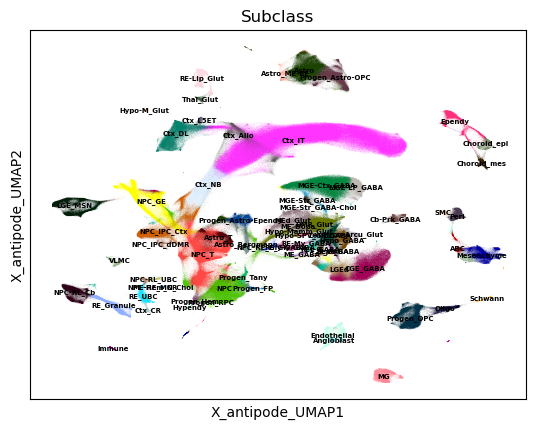

iteration 62


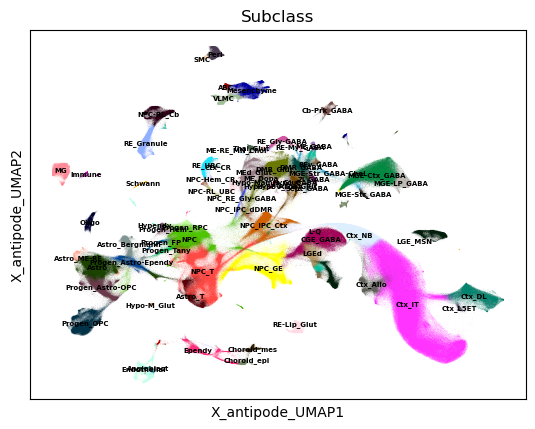

iteration 63


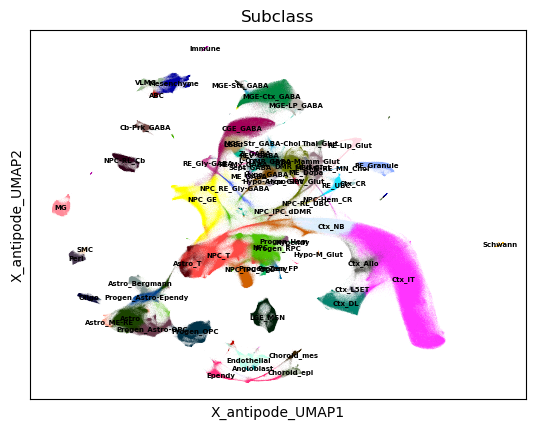

iteration 64


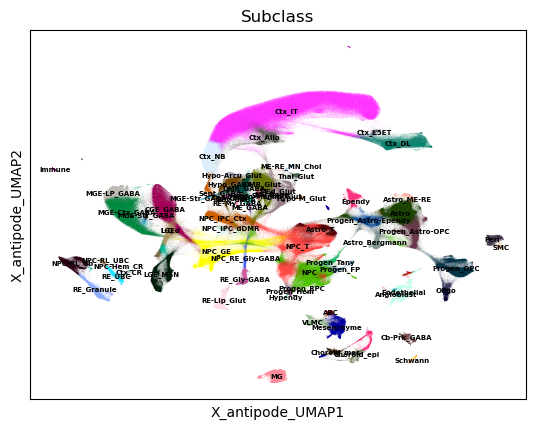

iteration 65


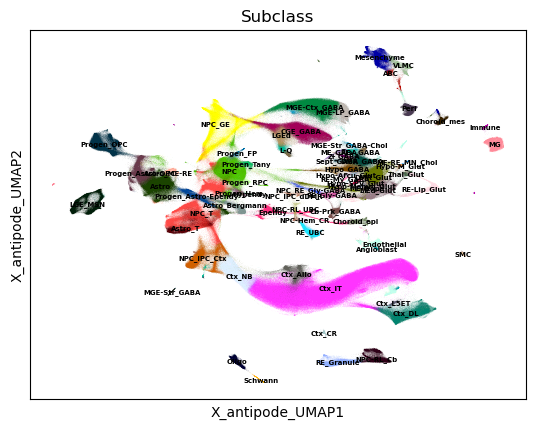

iteration 66


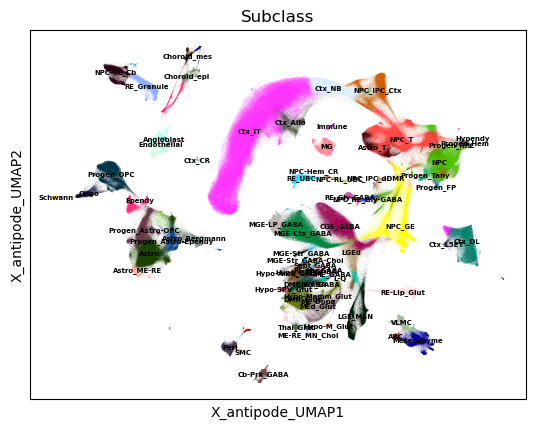

iteration 67


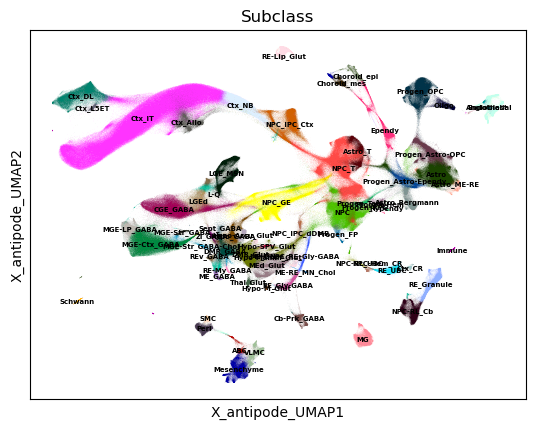

iteration 68


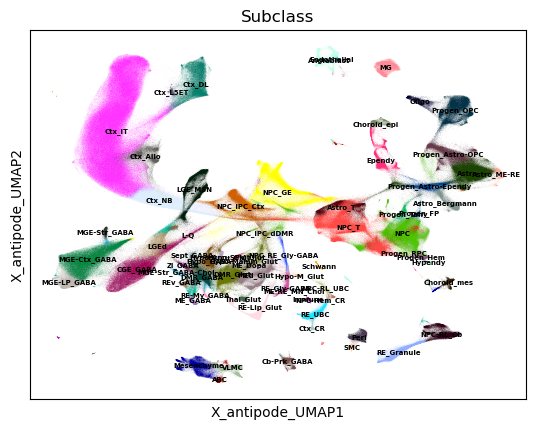

iteration 69


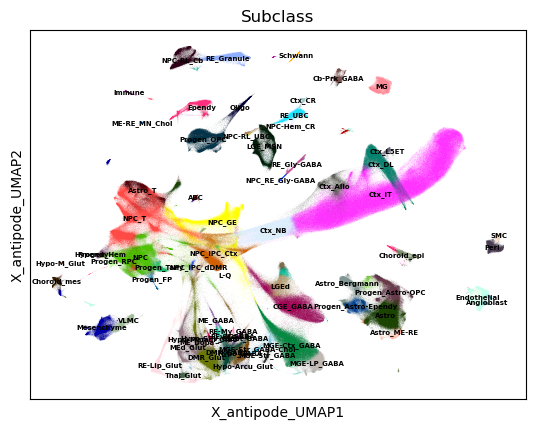

iteration 70


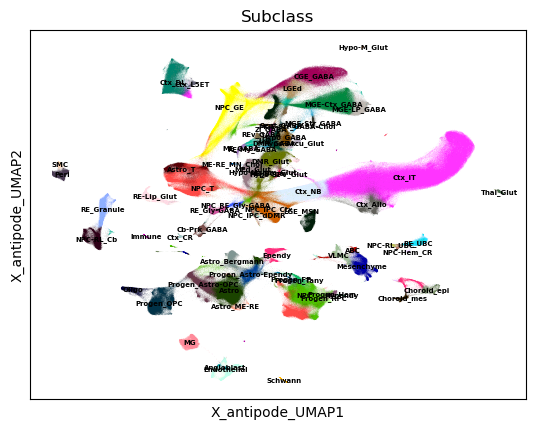

iteration 71


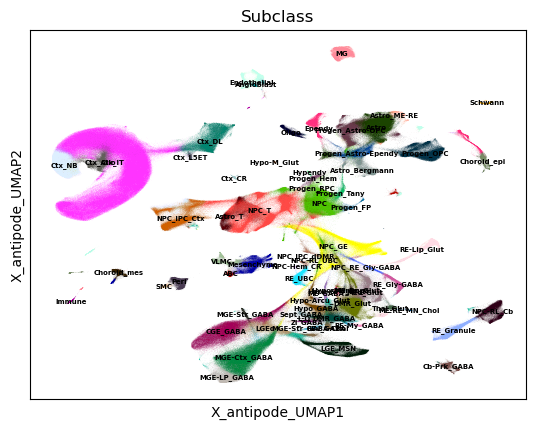

iteration 72


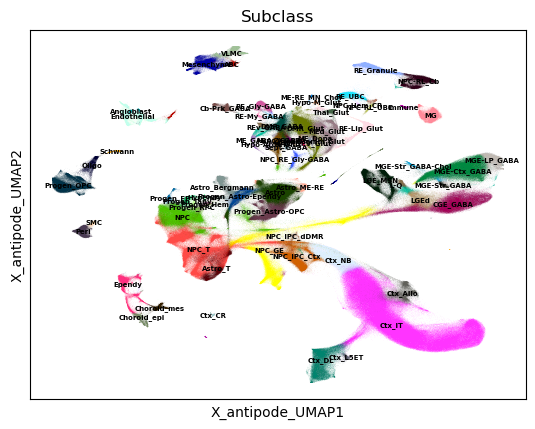

iteration 73


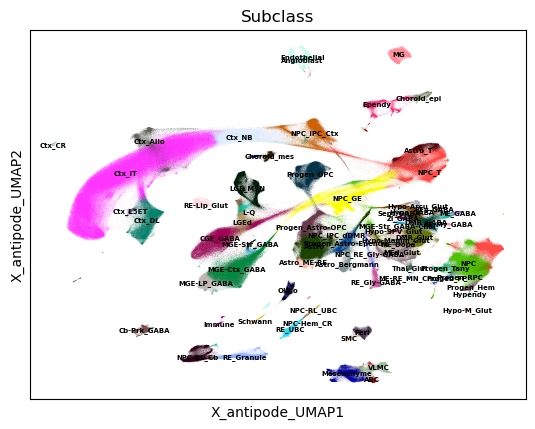

iteration 74


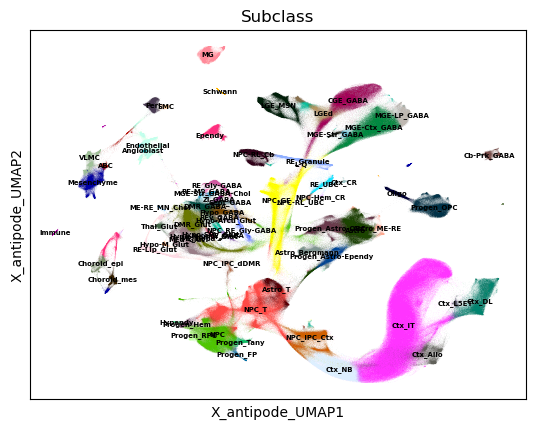

iteration 75


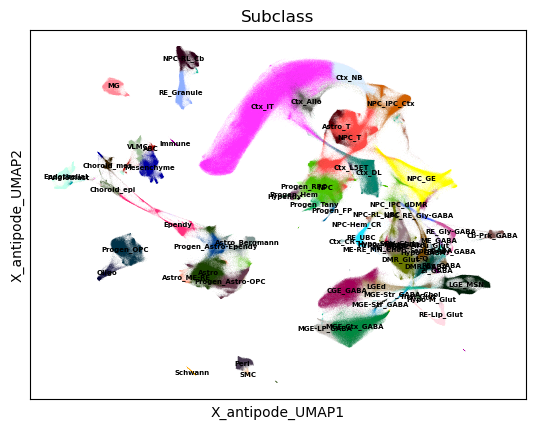

iteration 76


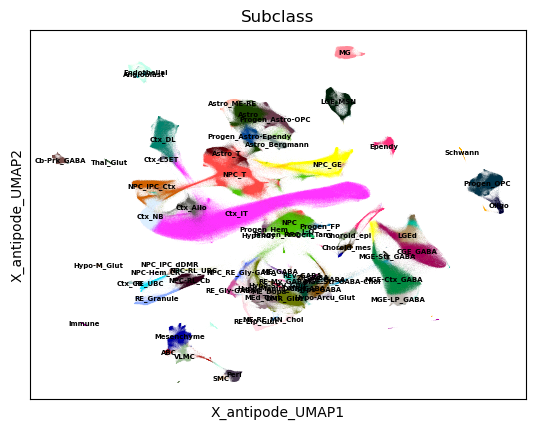

iteration 77


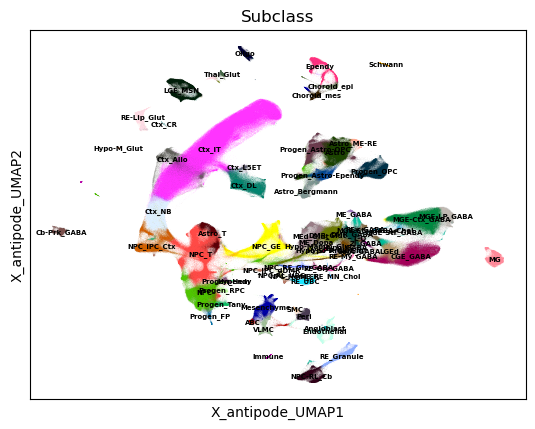

iteration 78


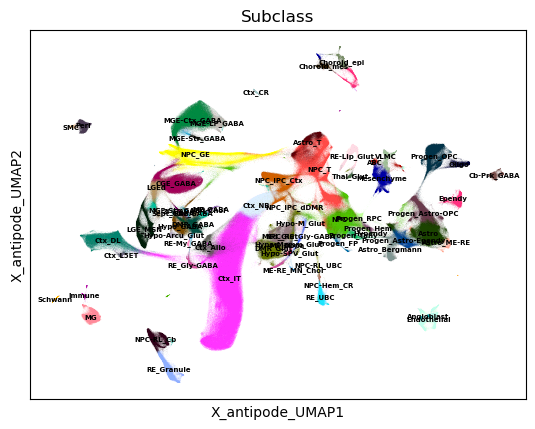

iteration 79


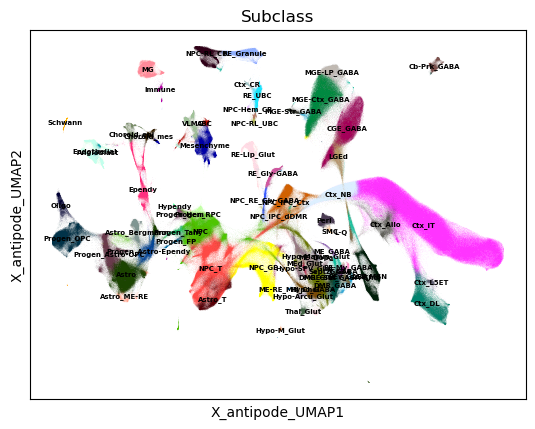

iteration 80


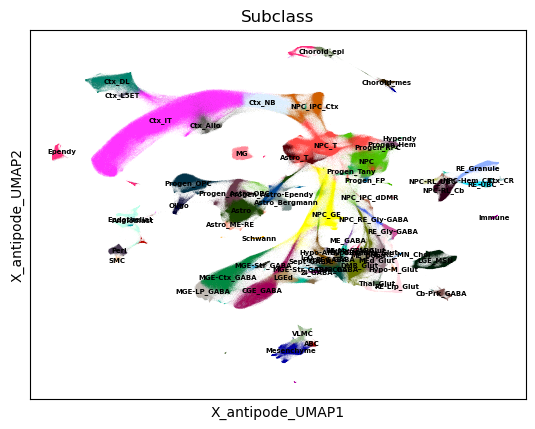

iteration 81


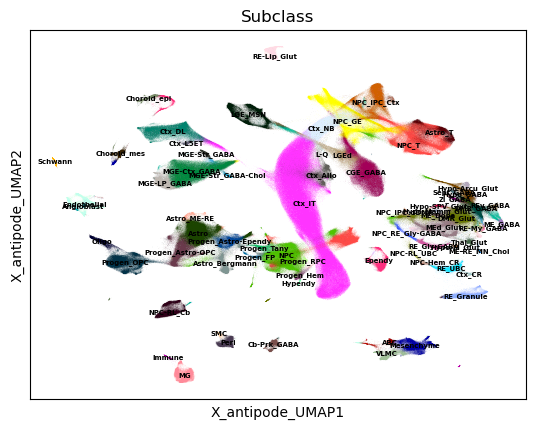

iteration 82


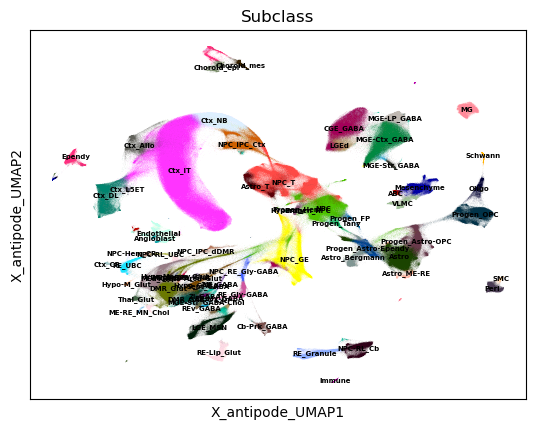

iteration 83


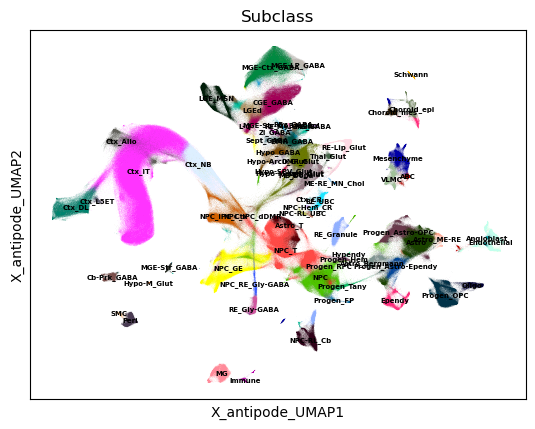

iteration 84


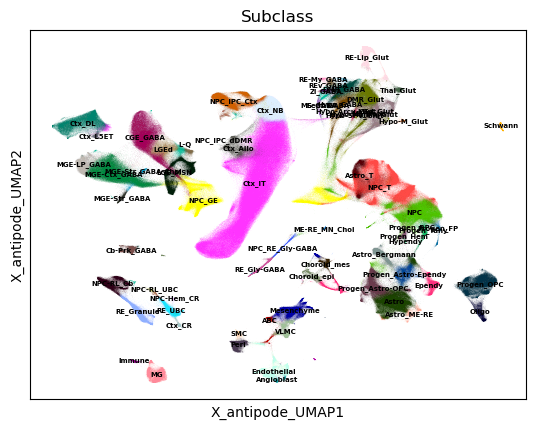

iteration 85


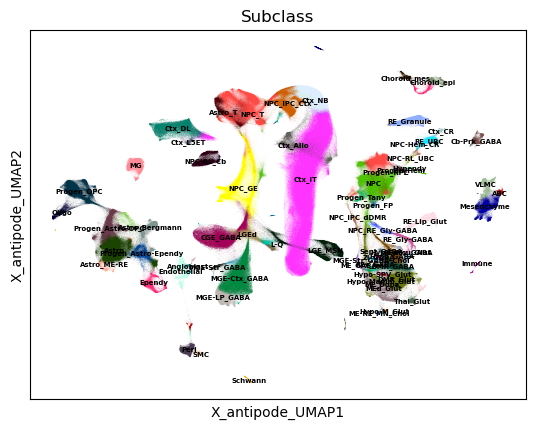

iteration 86


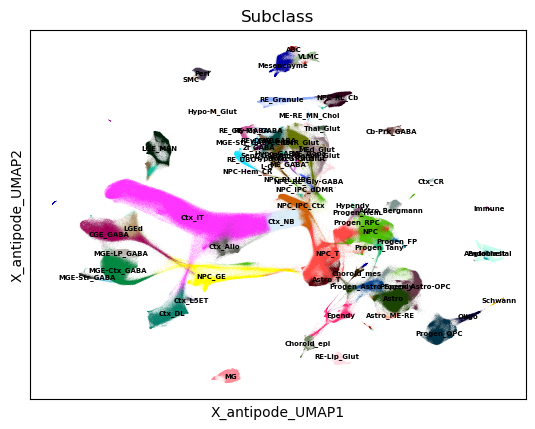

iteration 87


KeyboardInterrupt: 

In [23]:
for i in range(100):
    print('iteration',i)
    MDE_KEY = "X_antipode_UMAP"
    umap = cuml.UMAP(n_neighbors = 60,min_dist=0.23,spread=1,metric='manhattan')
    adata.obsm[MDE_KEY] = antipode.plotting.clip_latent_dimensions(umap.fit_transform(adata.obsm['X_antipode']),0.01)
    sc.pl.embedding(
        adata,
        basis=MDE_KEY,
        legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
        color=['Initial_Class']
    )
    np.savetxt(os.path.join(model_path,f"X_umap_{str(i)}.csv"), adata.obsm[MDE_KEY], delimiter=",")

In [24]:
good_umaps = [7,8,20,22,31,38,41,44,45,47,67,68,82]

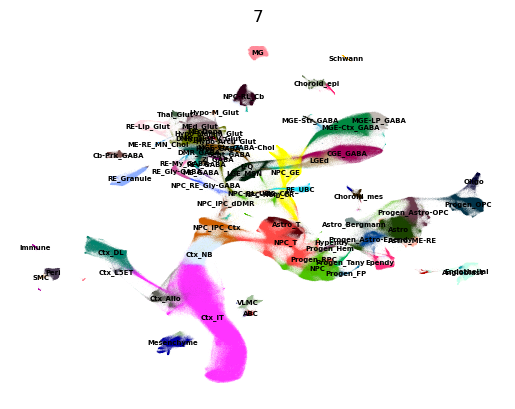

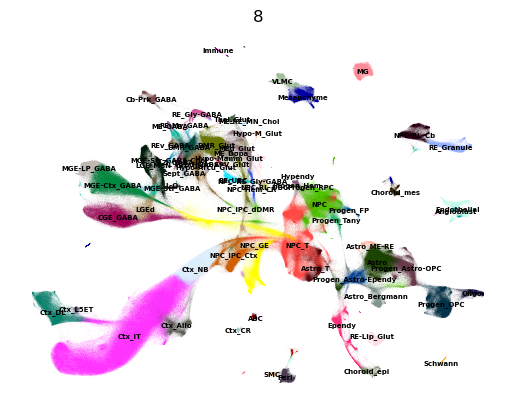

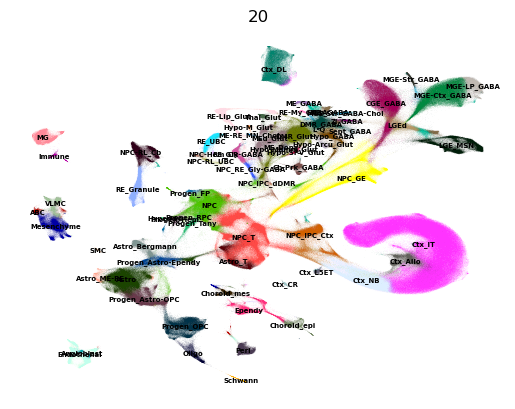

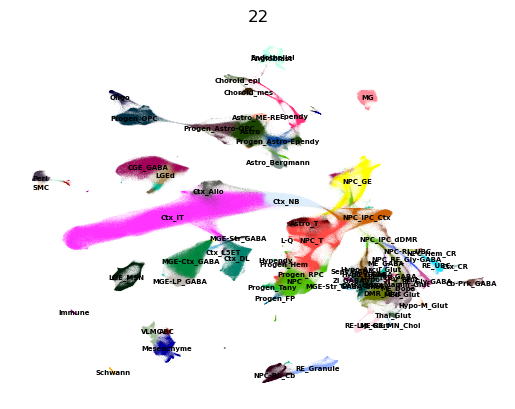

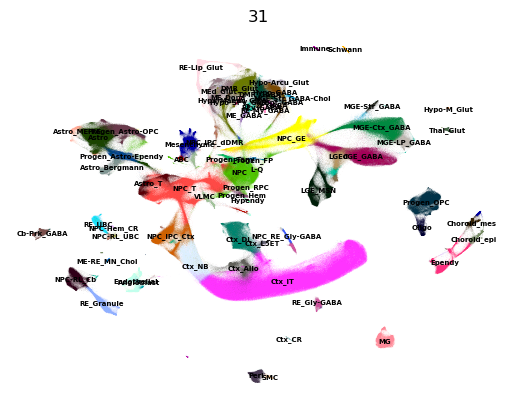

...

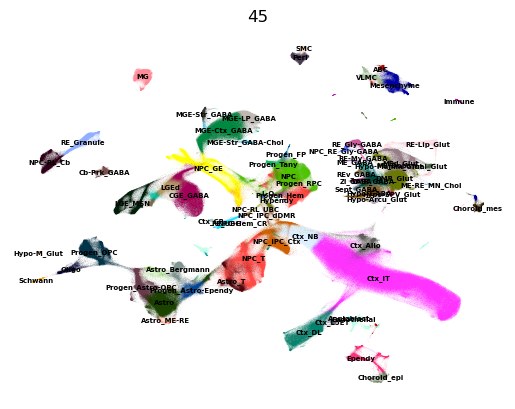

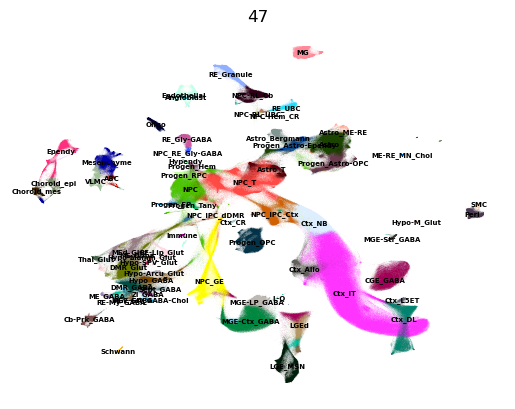

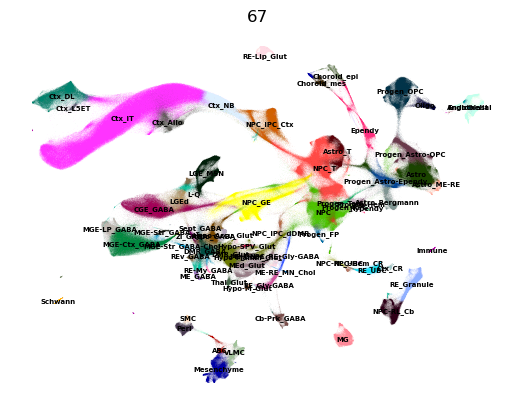

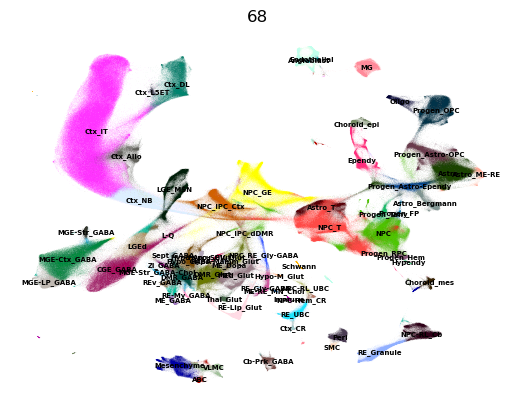

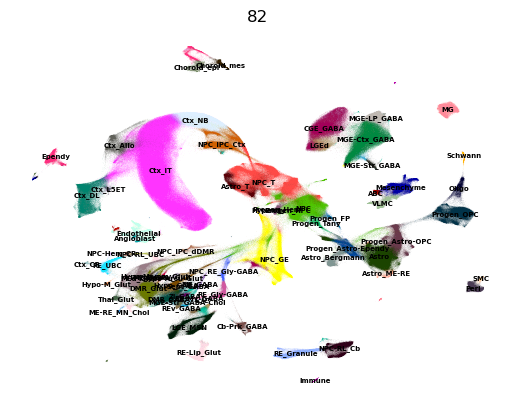

In [26]:
for i in good_umaps:
    adata.obsm['X_antipode_UMAP']=np.loadtxt(os.path.join(model_path,f"X_umap_{str(i)}.csv"), delimiter=",")
    sc.pl.embedding(
        adata,
        basis=MDE_KEY,
        legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
        color=['Initial_Class'],title=str(i),frameon=False
    )


In [29]:
good_umaps = [20,31,67,82]

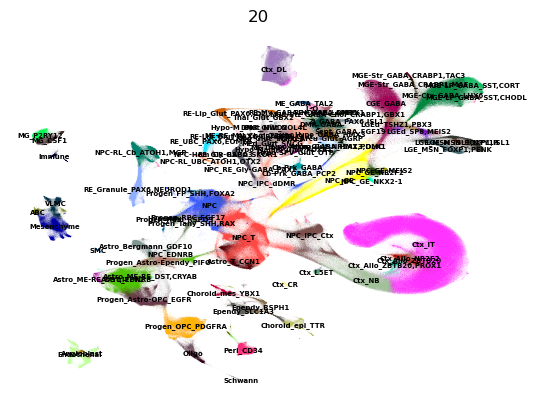

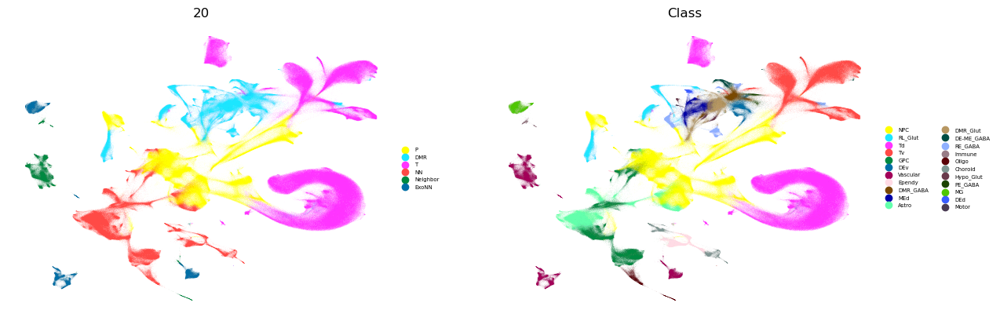

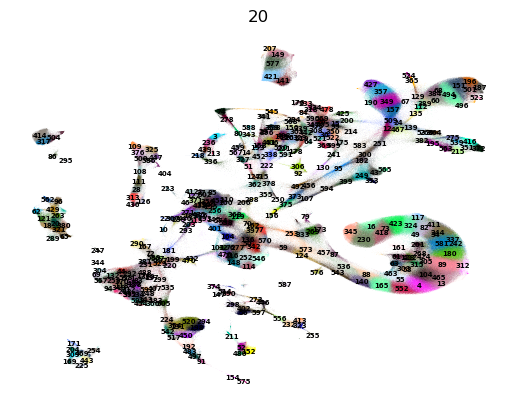

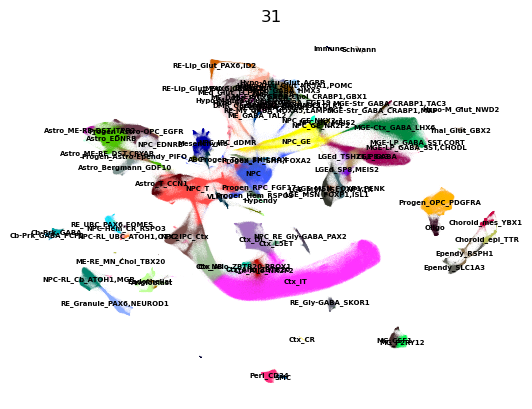

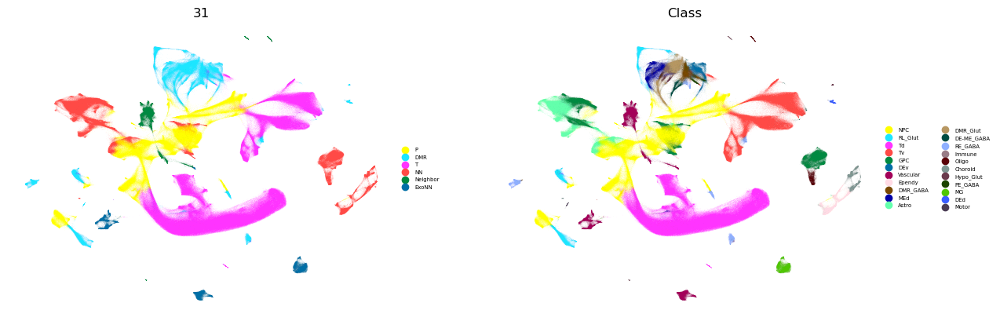

...

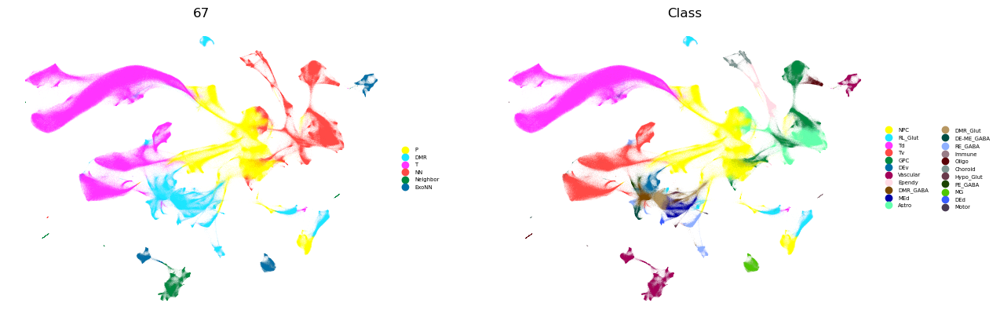

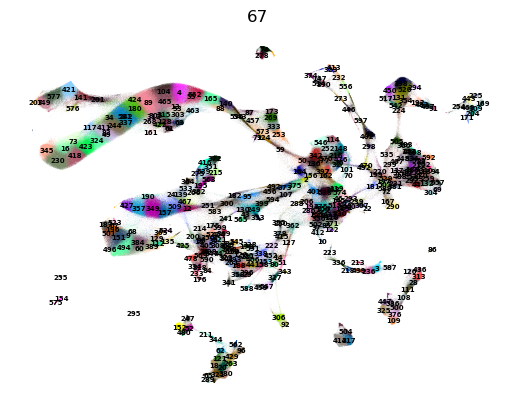

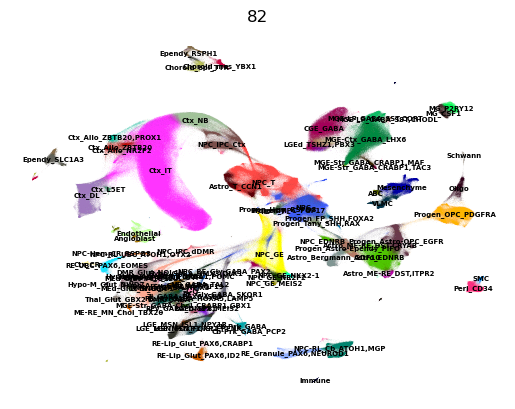

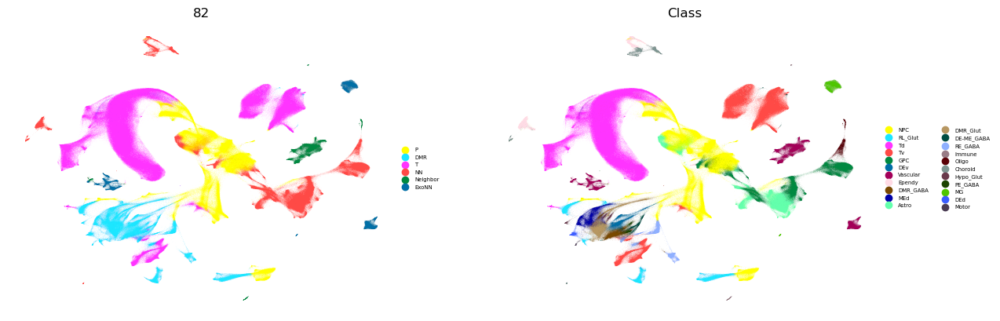

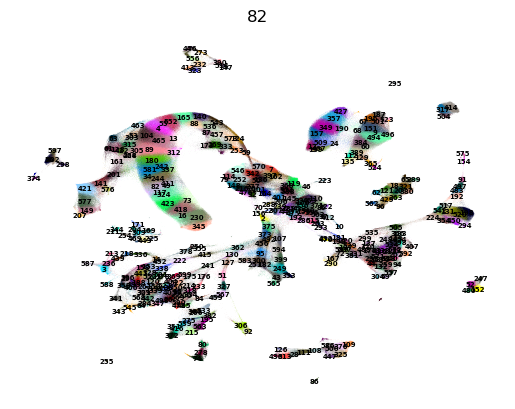

In [34]:
for i in good_umaps:
    adata.obsm['X_antipode_UMAP']=np.loadtxt(os.path.join(model_path,f"X_umap_{str(i)}.csv"), delimiter=",")
    sc.pl.embedding(
        adata,
        basis=MDE_KEY,
        legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
        color=['Initial_Class_markers'],title=str(i),frameon=False
    )
    sc.pl.embedding(
        adata,
        basis=MDE_KEY,
        palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
        color=['Neighborhood','Division'],title=str(i),frameon=False
    )
    sc.pl.embedding(
        adata,
        basis=MDE_KEY,
        legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
        color=['level_2'],title=str(i),frameon=False
    )

In [10]:
# np.savetxt(os.path.join(model_path,"X_umap.csv"), adata.obsm[MDE_KEY], delimiter=",")

In [35]:
adata.obsm['X_antipode_UMAP']=np.loadtxt(os.path.join(model_path,"X_umap.csv"), delimiter=",")

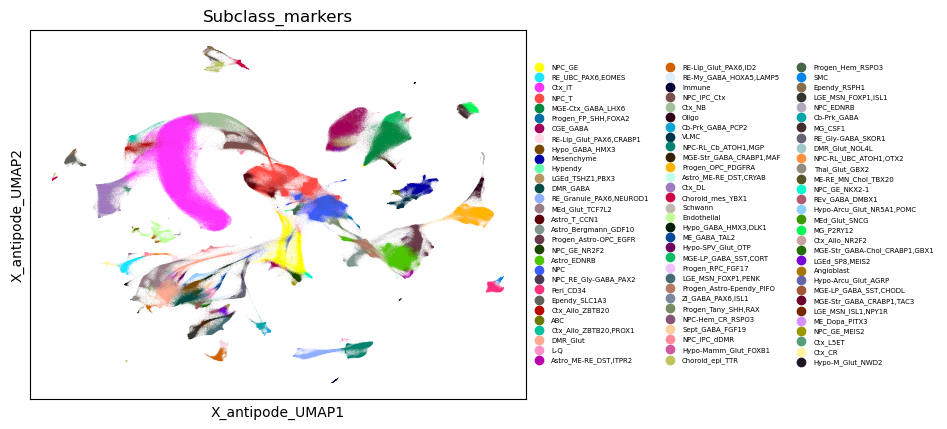

In [36]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
    color=['Initial_Class_markers']
)


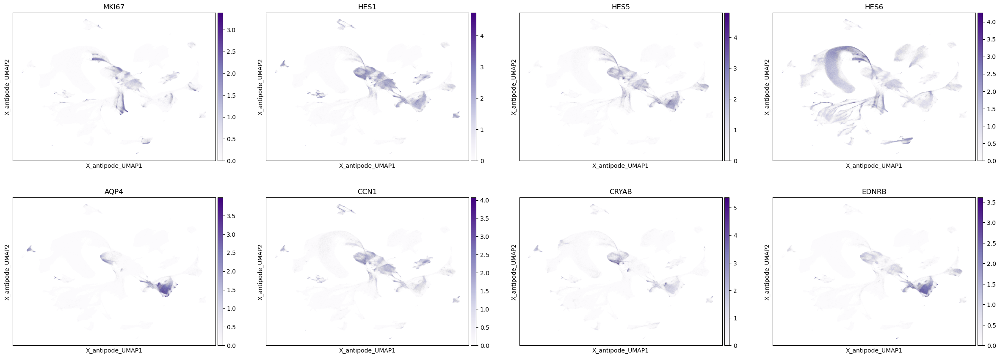

In [38]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    legend_loc='on data',palette=sc.pl.palettes.godsnot_102,cmap='Purples',
    color=['MKI67','HES1','HES5','HES6','AQP4','CCN1','CRYAB','EDNRB']
)

KeyError: 'Could not find key SPARCL in .var_names or .obs.columns.'

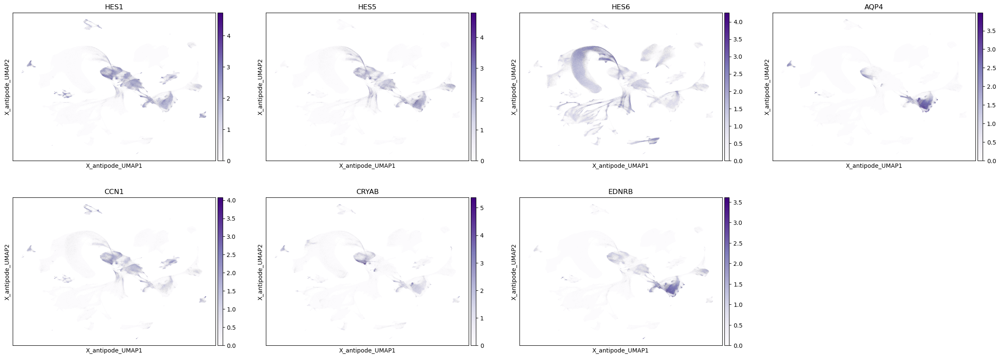

In [37]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    legend_loc='on data',palette=sc.pl.palettes.godsnot_102,cmap='Purples',
    color=['MKI67','HES1','HES5','HES6','AQP4','CCN1','CRYAB','EDNRB']
)

In [ ]:
dfsdfsd

In [198]:
adata.obs

,Class,G2M_score,S_score,Subclass,batch_name,female,general_region,log10_n_counts,new_ccl,new_neighborhood_extended,...,linnarson_extended,lamanno_class,lamanno_subclass,lamanno_cluster,neighborhood,curated_class_label,Neighborhood,Subclass_markers,core_markers,core_markers2
TAGTATGTAATA_e14-WT8,NPC,0.665049,0.042806,NPC,e14-WT8-1,False,ctx,4.120146,NPC,P,...,NPC,P,NPC,nan,P,Progen Cycling,P,NPC,nan,nan
TTCGCATAGGTT_e14-WT8,Ctx_Glut,-0.084758,-0.117966,Ctx_IT,e14-WT8-1,False,ctx,3.767379,Ctx_Allo,T,...,Ctx_Allo,T,Ctx_Allo,nan,O,Erythroid,T,Ctx_IT,nan,nan
CCTCCAATTGGC_e14-WT8,Ctx_Glut,-0.115723,-0.114059,Ctx_IT,e14-WT8-1,False,ctx,4.064121,Ctx_Allo,T,...,Ctx_Allo,T,Ctx_Allo,nan,T,Ctx Hip,T,Ctx_IT,nan,nan
CACGATATCCAT_e14-WT8,Vascular,0.273791,-0.049892,Endothelial,e14-WT8-1,False,ctx,4.045870,Endothelial,NN,...,Endothelial,ExoGlia,Endothelial,nan,NN,Endothelial,ExoNN,Endothelial,nan,nan
CAGCCGCGCCCT_e14-WT8,Ctx_Glut,-0.120023,-0.105050,Ctx_Allo,e14-WT8-1,False,ctx,4.047547,Ctx_Allo,T,...,Ctx_Allo,T,Ctx_Allo,nan,T,Ctx Hip,T,Ctx_Allo_ZBTB20,ZBTB20,nan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_musculus_RNA-Seq_kOut_GTTTCTATCAGTTAGC,Ctx_Glut,-0.147261,-0.100842,Ctx_IT,SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_mus...,SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_mus...,ctx,2.909556,NaN,T,...,Ctx_IT,T,Ctx_IT,nan,nan,nan,T,Ctx_IT,nan,nan
SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_musculus_RNA-Seq_kOut_TGTGTTTGTAGCGTAG,Ctx_Glut,-0.068897,-0.032346,Ctx_DL,SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_mus...,SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_mus...,ctx,2.974512,NaN,T,...,Ctx_DL,T,Ctx_L5ET,nan,nan,nan,T,Ctx_DL,nan,nan
SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_musculus_RNA-Seq_kOut_TACTCATCACCAGATT,Ctx_Glut,-0.061093,-0.063057,Ctx_IT,SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_mus...,SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_mus...,ctx,2.945469,NaN,T,...,Ctx_IT,T,Ctx_IT,nan,nan,nan,T,Ctx_IT,nan,nan
SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_musculus_RNA-Seq_kOut_GGGATGAGTTCGCGAC,CGE,-0.026970,-0.074085,CGE-Ctx_Gaba,SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_mus...,SRR12082764_GSM4635081_RNA-Seq_P1_rep2_Mus_mus...,ctx,2.903633,NaN,T,...,CGE-Ctx_Gaba,T,CGE-Ctx_Gaba,nan,nan,nan,T,CGE-Ctx_Gaba,nan,nan


In [199]:
# new_annos = pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/annotations/review_annotation.csv',index_col=0,skiprows=2)
new_annos = pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/annotations/review_annotation_3.csv',index_col=0,skiprows=2)
adata.obs['new_ccl'] = new_annos['new_ccl']
adata.obs['new_neighborhood'] = new_annos['new_neighborhood']
adata.obs['ccl_extended']=adata.obs[leaf_key].replace(adata.obs.groupby(leaf_key)['new_ccl'].value_counts().unstack().idxmax(1).to_dict())
adata.obs['new_neighborhood_extended']=adata.obs[leaf_key].replace(adata.obs.groupby(leaf_key)['new_neighborhood'].value_counts().unstack().idxmax(1).to_dict())

/scratch/fast/441475/ipykernel_1618585/1729121816.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs['ccl_extended']=adata.obs[leaf_key].replace(adata.obs.groupby(leaf_key)['new_ccl'].value_counts().unstack().idxmax(1).to_dict())
/scratch/fast/441475/ipykernel_1618585/1729121816.py:5: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['ccl_extended']=adata.obs[leaf_key].replace(adata.obs.groupby(leaf_key)['new_ccl'].value_counts().unstack().idxmax(1).to_dict())
/scratch/fast/441475/ipykernel_1618585/1729121816.py:6: FutureWarning: The default of observed=False is depreca

In [17]:
import h5py
with h5py.File('/home/matthew.schmitz/Matthew/models/1.9.1.8.5_Dev_final_noQ_INP_moredim_regionsample/analysis_inprogress.h5ad') as f:
    obs = anndata.io.read_elem(f['obs'])

In [18]:
# new_dmr = pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/hct_ux3_cellxgene/anndata_080/V1Evo/dmr_subset_annotations/dmr_anno.csv',skiprows=2,index_col=0)
# adata.obs['new_dmr'] = 'nan'
# adata.obs['new_dmr'] = new_dmr['quick_anno']
# tab = adata.obs.groupby('level_2')['new_dmr'].value_counts().unstack()#.idxmax(1)
# tab = tab.loc[tab.sum(1)>10,:]
# pd.DataFrame(tab.idxmax(1)).T.to_csv('~/test.csv',sep=',')
# obs['core_markers'] = obs['level_2'].astype(str).replace(dict(zip(list(cluster_meta['level_2'].astype(str)),list(cluster_meta['core_markers']))))
# obs['core_markers2'] = obs['level_2'].astype(str).replace(dict(zip(list(cluster_meta['level_2'].astype(str)),list(cluster_meta['core_markers2']))))
# adata.obs['Initial_Class'] = obs['Initial_Class']
# adata.obs['Division'] = obs['Division']
# adata.obs['core_markers'] = obs['core_markers']
# adata.obs['core_markers2'] = obs['core_markers2']
# mappings=pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/annotations/clustermeta1_to_cell_annotations.tsv',sep='\t',index_col=0)
# adata.obs.loc[:,mappings.columns] = mappings
# adata.obs.loc[:,mappings.columns] = adata.obs.loc[:,mappings.columns].astype(str)


# cluster_meta = pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/annotations/cluster_meta_3.tsv',sep='\t')
# for c in ['Neighborhood','Division','Initial_Class','Initial_Class_markers','core_markers','core_markers2']:
#     print(c)
#     d = dict(zip(cluster_meta['level_2'].astype(str),cluster_meta[c].astype(str)))
#     adata.obs[c] = adata.obs['level_2'].astype(str).replace(d)


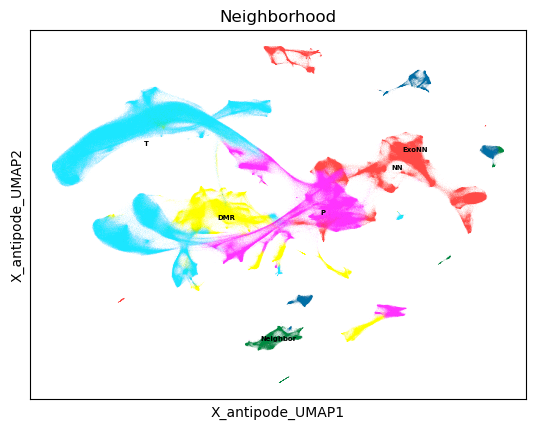

In [200]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
    color=['Neighborhood']
)


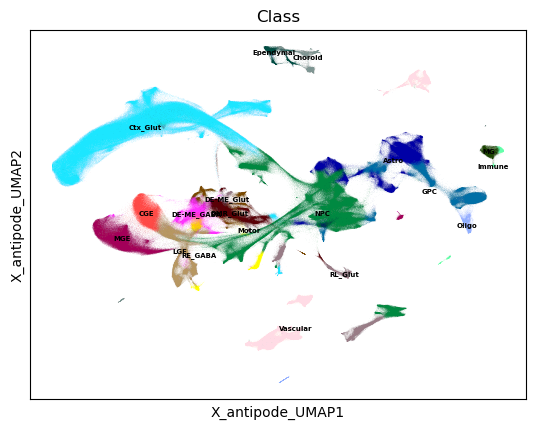

In [201]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
    color=['Division']
)


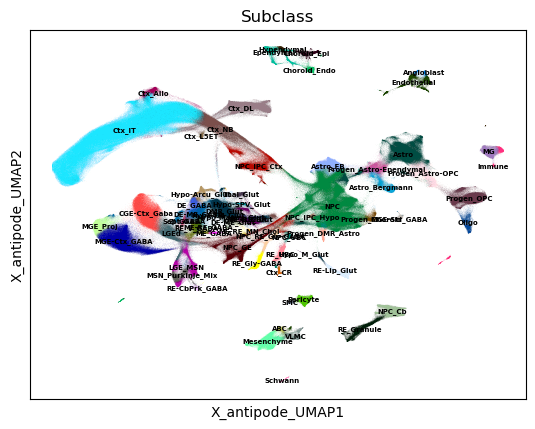

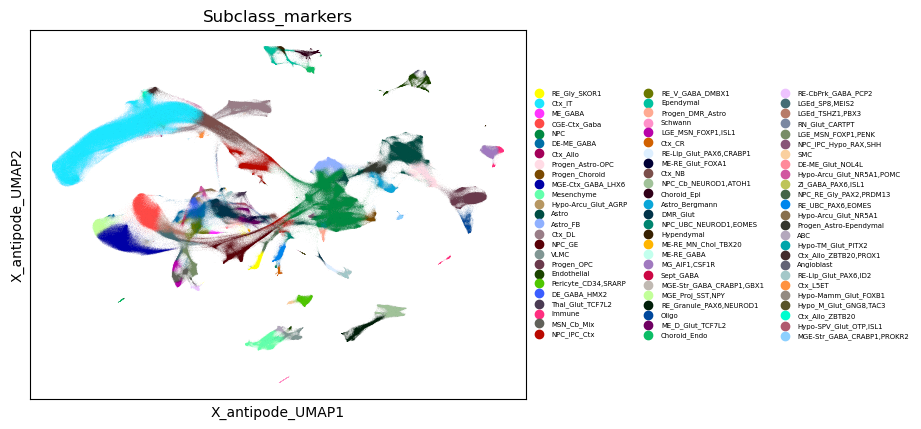

In [202]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
    color=['Initial_Class']
)
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
    color=['Initial_Class_markers']
)


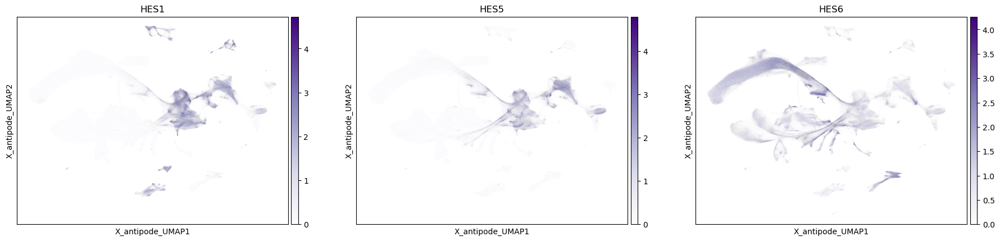

In [203]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    legend_loc='on data',palette=sc.pl.palettes.godsnot_102,cmap='Purples',
    color=['HES1','HES5','HES6']
)

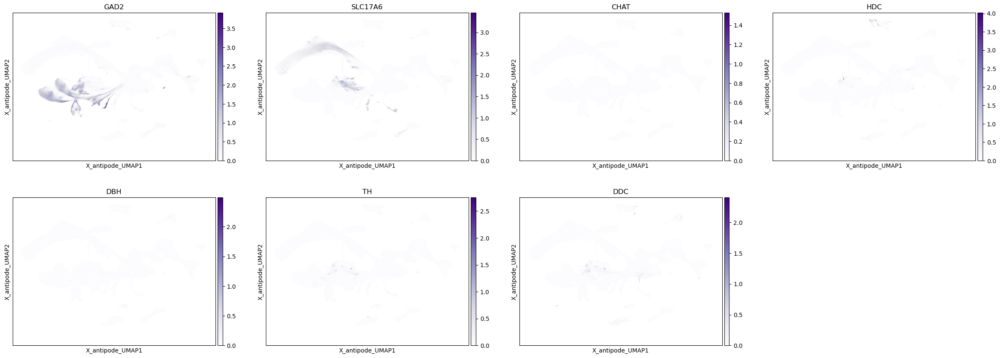

In [207]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    legend_loc='on data',cmap='Purples',legend_fontsize=5,
    color=['GAD2','SLC17A6','CHAT','HDC','DBH','TH','DDC']
)

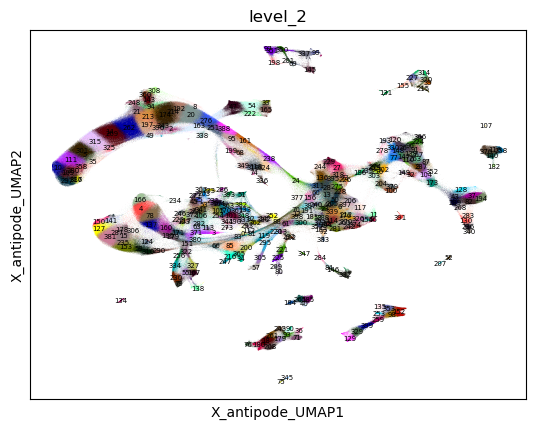

In [208]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,legend_fontweight='medium',
    color=['level_2']
)

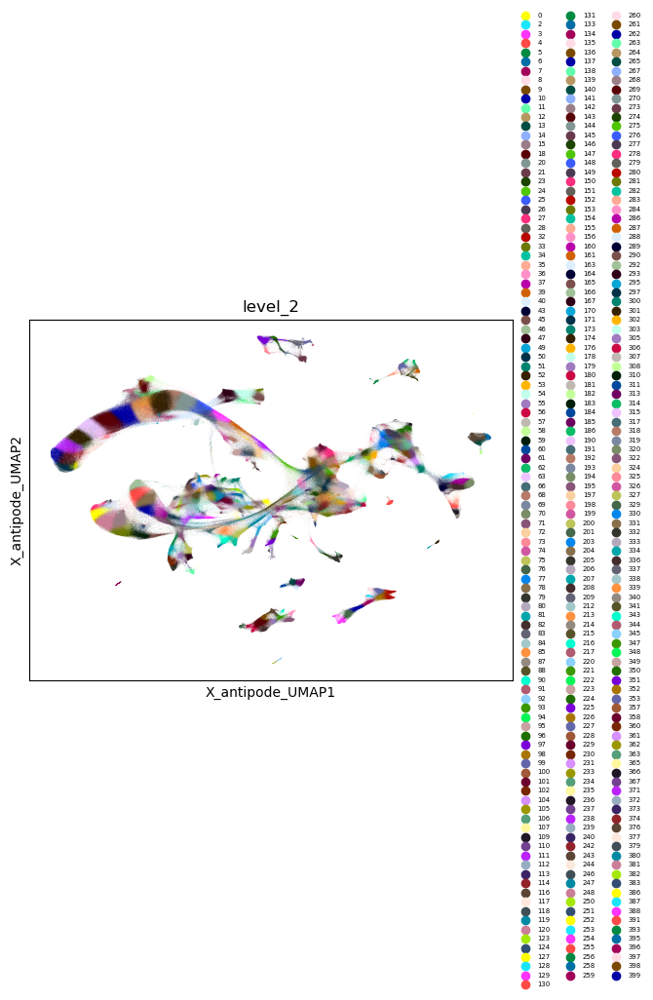

In [209]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
    color=['level_2']
)

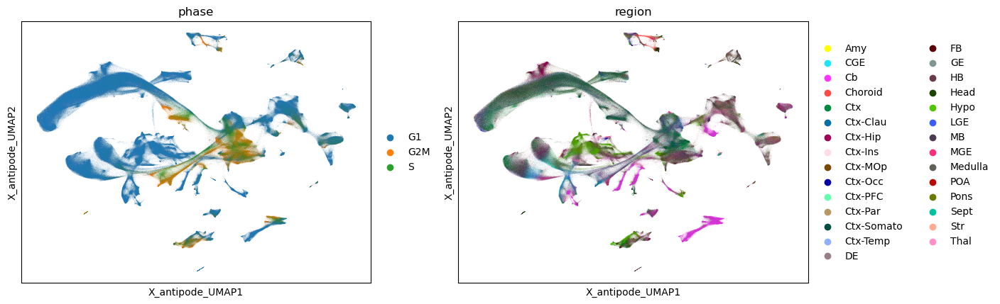

In [210]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['phase','region']
)

In [211]:
# aggr_means=antipode.model_functions.group_aggr_anndata(adata,[discov_key,'level_2'],layer=layer_key,normalize=True)
# aggr_sums=antipode.model_functions.group_aggr_anndata(adata,['level_2'],layer=layer_key,normalize=False,agg_func=np.sum)
# log_real_means=antipode.model_functions.safe_log_transform(aggr_means[0],aggr_sums[0].sum(-1)[np.newaxis,...,np.newaxis])
log_real_means,real_mean_levels=antipode.model_functions.get_real_leaf_means(adata,discov_key,leaf_key,layer=layer_key)
real_means=pd.DataFrame(log_real_means.mean(0),columns=adata.var.index,index=real_mean_levels[leaf_key])
real_means=real_means.loc[real_mean_levels[leaf_key],:]

100%|██████████| 316/316 [01:21<00:00,  3.88it/s]


In [212]:
ccl_aggr_means=antipode.model_functions.group_aggr_anndata(adata,[discov_key,'Initial_Class'],layer=layer_key,normalize=True)
ccl_aggr_sums=antipode.model_functions.group_aggr_anndata(adata,['Initial_Class'],layer=layer_key,normalize=False,agg_func=np.sum)
ccl_log_real_means=antipode.model_functions.safe_log_transform(ccl_aggr_means[0],ccl_aggr_sums[0].sum(-1)[np.newaxis,...,np.newaxis])


100%|██████████| 66/66 [01:19<00:00,  1.20s/it]


In [213]:
pstore = adata.uns['param_store']
discov_cluster_params,cluster_params, cluster_labels,var_labels, zero_mask,(prop_taxon, prop_locs,prop_discov_di,prop_discov_dm)=antipode_model.calculate_cluster_params(flavor='numpy')
keep_clusters = np.array([x in adata.obs['level_2'].unique() for x in cluster_labels ])
cluster_labels = np.array(cluster_labels)[keep_clusters]
zero_mask = zero_mask[:,keep_clusters,:]
cluster_index = np.array([int(x) for x in cluster_labels])
zero_mask = np.nan_to_num(zero_mask,posinf=np.nan)
discov_cluster_params = discov_cluster_params[:,cluster_index,:] * zero_mask
prop_locs = prop_locs[cluster_index,:]
prop_discov_di = prop_discov_di[:,cluster_index,:] * zero_mask
prop_discov_dm = prop_discov_dm[:,cluster_index,:] * zero_mask
discov_labels=adata.obs[antipode_model.discov_key].cat.categories
latent_labels=[str(x) for x in range(pstore['discov_dc'].shape[1])]
n_clusters=antipode_model.level_sizes[-1]

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/antipode_mixins.py:450: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  zero_mask = (adata.obs.groupby(self.discov_key)[leaf_level].value_counts().unstack().loc[:,cluster_labels]>=cluster_count_threshold).to_numpy()
/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/antipode_mixins.py:451: RuntimeWarning: divide by zero encountered in divide
  return discov_cluster_params,cluster_params, cluster_labels,var_labels, 1/zero_mask[...,np.newaxis],(prop_taxon, prop_locs,prop_discov_di,prop_discov_dm)


In [214]:
clipped_expr_df = pd.DataFrame(np.clip(discov_cluster_params,a_min=-20,a_max=1e10).mean(0),columns=adata.var.index,index=cluster_labels)

In [215]:
quantile = 0.98
coefdf = antipode.post.get_conserved_quantile_markers(discov_cluster_params,columns=adata.var.index,index=cluster_labels, q=quantile,antimarker=False)
selected_markers = antipode.post.select_marker_genes(
    coefdf, clipped_expr_df, marker=True,
    threshold=np.log(5/1e6))
# marker_gene_order=uniqlist([selected_markers[x] for x in adata.uns['dendrogram_level_2']['categories_ordered']])

100%|██████████| 316/316 [15:43<00:00,  2.99s/it]


In [216]:
ccl_coefdf = antipode.post.get_conserved_quantile_markers(ccl_log_real_means,columns=adata.var.index,index=adata.obs['Initial_Class'].cat.categories, q=quantile,antimarker=False)

100%|██████████| 66/66 [02:51<00:00,  2.59s/it]


In [217]:
# Function to get mode value (first mode if there are multiple)
def get_mode(series):
    return series.mode().iloc[0] if not series.mode().empty else np.nan

# Function to return top n marker genes from a row (sorted descending by coefficient)
def get_top_n_markers(row, n=5):
    return list(row.sort_values(ascending=False).head(n).index)

# Function to calculate top n regions with proportions formatted as "region (prop%)"
def get_top_regions(series, n=3):
    counts = series.value_counts(normalize=True)
    top_n = counts.head(n)
    return ", ".join([f"{idx} ({prop:.1%})" for idx, prop in top_n.items()])

# Group obs by level_2
grouped = adata.obs.groupby('level_2')
vcs = adata.obs['level_2'].value_counts()
results = []
for level2, group in grouped:
    mode_level_1 = get_mode(group['level_1'])
    mode_new_neighborhood = get_mode(group['Neighborhood'])
    mode_class = get_mode(group['Division'])
    mode_Initial_Class = get_mode(group['Initial_Class'])
    mode_Initial_Class_markers = get_mode(group['Initial_Class_markers'])
    mode_core_markers = get_mode(group['core_markers'].astype(str).replace('nan',''))
    mode_core_markers2 = get_mode(group['core_markers2'].astype(str).replace('nan',''))
    mode_abc = get_mode(group['abc_Initial_Class_markercor'])
    top_regions = get_top_regions(group['region'], n=3)
    
    # Top 5 markers for level_2 from gene_markers
    if level2 in coefdf.index:
        top5_level2 = get_top_n_markers(coefdf.loc[level2])
    else:
        top5_level2 = []
    
    # Top 5 markers for the level_2's assigned ccl_extended from ccl_markers
    if mode_Initial_Class in ccl_coefdf.index:
        top5_ccl = get_top_n_markers(ccl_coefdf.loc[mode_Initial_Class])
    else:
        top5_ccl = []
    
    results.append({
        'level_2': level2,
        'level_1': mode_level_1,
        'Neighborhood': mode_new_neighborhood,
        'Division':mode_class,
        'Initial_Class':mode_Initial_Class,
        'Initial_Class_markers':mode_Initial_Class_markers,
        'core_markers':mode_core_markers,
        'core_markers2':mode_core_markers2,
        'abc_Initial_Class_markercor': mode_abc,
        'n_cells':vcs[level2],
        'top_regions': top_regions,
        'top5_markers_level2': ", ".join(top5_level2),
        'top5_markers_ccl': ", ".join(top5_ccl)
    })

result_df = pd.DataFrame(results)
result_df = result_df.sort_values('Initial_Class')  # order by ccl_extended alphabetically

print(result_df)
result_df.to_csv(os.path.join(sc.settings.figdir,'cluster_metadata4.tsv'),sep='\t')

/scratch/fast/441475/ipykernel_1618585/2630462707.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby('level_2')


    level_2 level_1 Neighborhood       Class    Subclass   Subclass_markers  \
197     243      25     Neighbor    Vascular         ABC                ABC   
253     314      27        ExoNN    Vascular  Angioblast         Angioblast   
242     300       8           NN       Astro       Astro              Astro   
265     330      18           NN       Astro       Astro              Astro   
21       26      18           NN       Astro       Astro              Astro   
..      ...     ...          ...         ...         ...                ...   
38       51      30          DMR  DE-ME_Glut   Thal_Glut   Thal_Glut_TCF7L2   
55       71      25     Neighbor    Vascular        VLMC               VLMC   
75       93      25     Neighbor    Vascular        VLMC               VLMC   
28       36      25     Neighbor    Vascular        VLMC               VLMC   
175     217       3          DMR  DE-ME_GABA     ZI_GABA  ZI_GABA_PAX6,ISL1   

    core_markers core_markers2         abc_subclass

In [206]:
adata.write_h5ad(os.path.join(model_path,'analysis_inprogress.h5ad'))

In [218]:
adata = adata[adata.obs['Neighborhood']=='DMR',:]

In [223]:
MDE_KEY = "X_antipode_UMAP"
umap = cuml.UMAP(n_neighbors = 60,min_dist=0.23,spread=1,metric='manhattan')
adata.obsm[MDE_KEY] = antipode.plotting.clip_latent_dimensions(umap.fit_transform(adata.obsm['X_antipode']),0.01)
# print('done')

In [ ]:
# MDE_KEY = "X_umap"
# sc.pp.neighbors(adata,n_neighbors=30,use_rep='X_antipode')
# sc.tl.umap(adata)

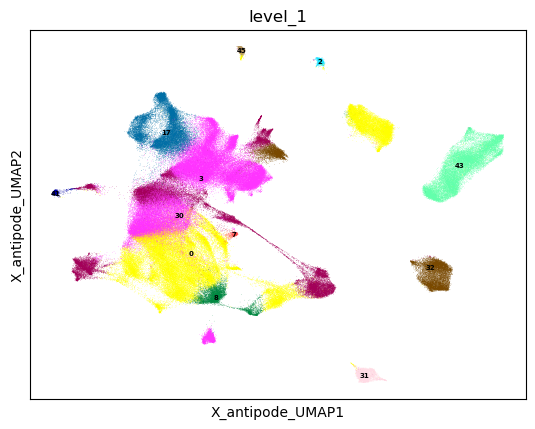

In [224]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
    color=['level_1']
)

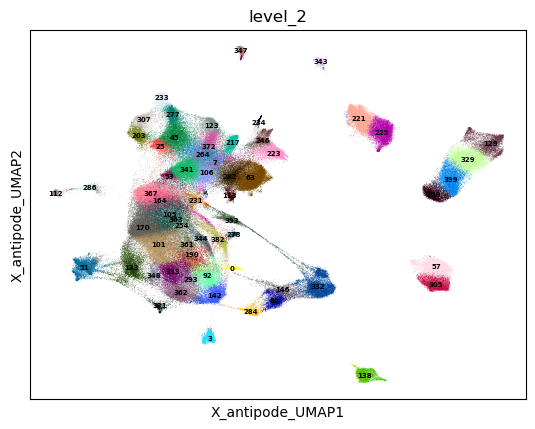

In [225]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
    color=['level_2']
)

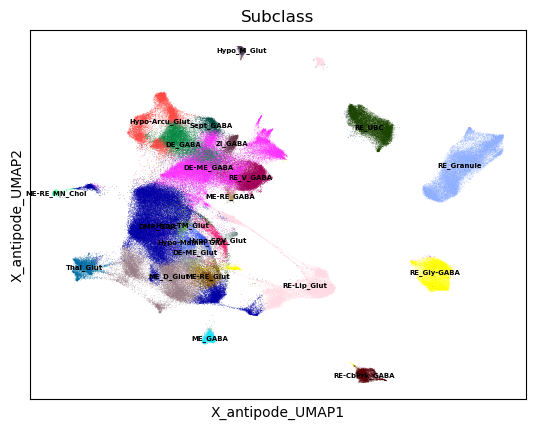

In [226]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
    color=['Initial_Class']
)

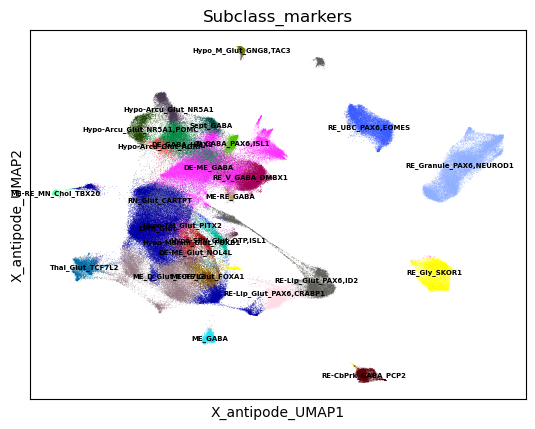

In [227]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    legend_loc='on data',palette=sc.pl.palettes.godsnot_102,legend_fontsize=5,
    color=['Initial_Class_markers']
)

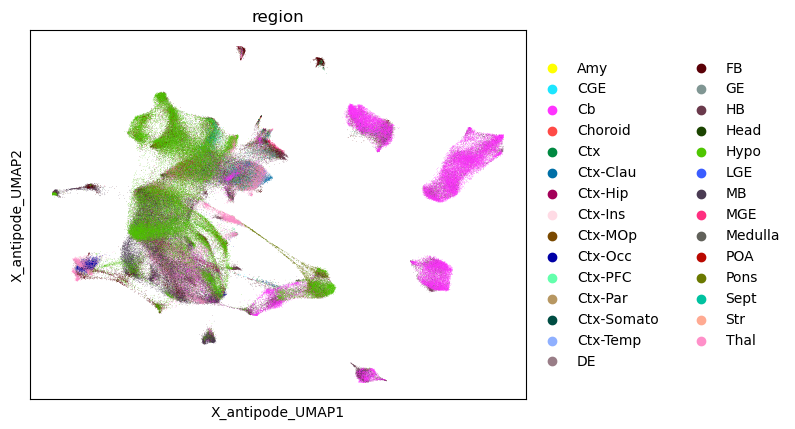

In [228]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['region']
)

In [231]:
for x in list(adata.layers.keys()):
    del adata.layers[x]
for x in list(adata.uns.keys()):
    if not 'color' in x:
        del adata.uns[x]
for x in list(adata.obsp.keys()):
    del adata.obsp[x]


In [232]:
adata.obs = adata.obs.loc[:,['Division', 'G2M_score', 'S_score', 'Initial_Class', 'batch_name','general_region', 'log10_n_counts','phase', 'region', 'species', 'timepoint', 'Neighborhood', 'Initial_Class_markers', 'abc_Initial_Class_markercor', 'juv_Initial_Class_markercor']]

In [ ]:
adata.write_h5ad(os.path.join(model_path,'dmr_subset.h5ad'))

In [ ]:
model_path